In [1]:
import sys

sys.path.insert(0, "../data_gen/")
sys.path.insert(0, "../net/")
sys.path.insert(0, "../eval/")

import os
import numpy as np
import scipy.misc
from heatmap_process import post_process_heatmap
from hourglass import HourglassNet
import argparse
from pckh import run_pckh
from mpii_datagen import MPIIDataGen
import cv2
import pickle
import pydicom
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
import keras as k
from heatmap_process import post_process_heatmap


Using TensorFlow backend.


In [33]:
from pydicom.pixel_data_handlers.util import apply_voi_lut

input_folder = '/home/d/demeter19/torch/true_patients/first_patient/'

def load_dcms(folder):
    lstFilesDCM = []  # create an empty list
    for dirName, subdirList, fileList in os.walk(folder):
        fileList = sorted(fileList)
        for filename in fileList:
            if ".dcm" in filename.lower():  # check whether the file's DICOM
                lstFilesDCM.append(os.path.join(dirName,filename))
    return lstFilesDCM
dcms = load_dcms = load_dcms(input_folder)
print(len(dcms))

def render_joints(cvmat, joints, conf_th=0.2):
    kidney1 = joints[0][0], joints[0][1]
    kidney2 = joints[1][0], joints[1][1]
    
    cv2.circle(cvmat, center=(int(kidney1[0][0]), int(kidney1[0][1])), color=(255, 0, 0), radius=3, thickness=2)
    cv2.circle(cvmat, center=(int(kidney1[1][0]), int(kidney1[1][1])), color=(255, 0, 0), radius=3, thickness=2)

    cv2.circle(cvmat, center=(int(kidney2[0][0]), int(kidney2[0][1])), color=(255, 0, 0), radius=3, thickness=2)
    cv2.circle(cvmat, center=(int(kidney2[1][0]), int(kidney2[1][1])), color=(255, 0, 0), radius=3, thickness=2)

#     for _joint in joints:
#         _x, _y = _joint
#         cv2.circle(cvmat, center=(int(_x), int(_y)), color=(255, 0, 0), radius=3, thickness=2)

    return cvmat

def convert_to_array(dcms, img_size = (227, 227)):
    imgs = []
    for filenameDCM in dcms:
        ds = pydicom.read_file(filenameDCM)
        img = ds.pixel_array

        ds.WindowCenter = [40, 1100]
        ds.WindowWidth = [300, 500]

        img = apply_voi_lut(img, ds, index=1)
        img = img - np.min(img)
        img = img / np.max(img)
        img = img * 255
        img = Image.fromarray(img)                                 
        img = img.resize(img_size, Image.ANTIALIAS)
        img = np.array(img)
        imgs.append(img)
    imgs = np.array(imgs)
    return np.array(imgs)

# images = convert_to_array(dcms)
# print(images.shape)

499


In [4]:
from demo import inference_folder
import timeit

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = str(0)

# model_json = '/home/d/demeter19/diplomovka/Stacked_Hourglass_Network_Keras/src/models/selectedPatientsAug/net_arch.json'
# model_weights = '/home/d/demeter19/diplomovka/Stacked_Hourglass_Network_Keras/src/models/selectedPatientsAug/weights/weights_epoch60.h5'
model_json = '/home/d/demeter19/diplomovka/Stacked_Hourglass_Network_Keras/src/models/shuffledPatientsAug/net_arch.json'
model_weights = '/home/d/demeter19/diplomovka/Stacked_Hourglass_Network_Keras/src/models/shuffledPatientsAug/weights/weights_epoch80.h5'
num_stack = 2
num_class = 4
output_folder = '/home/d/demeter19/diplomovka/Stacked_Hourglass_Network_Keras/src/top/true_patients_predictions'

confidence_threshold = 0.1

0
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


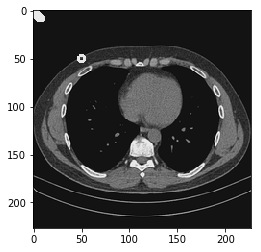

1
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


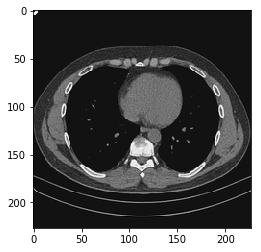

2
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


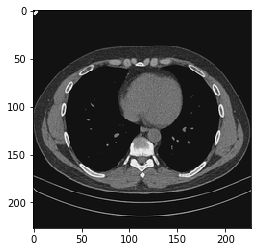

3
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


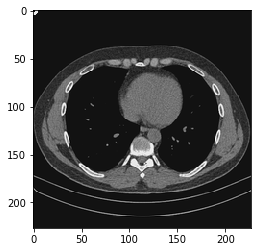

4
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


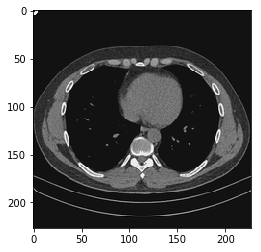

5
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


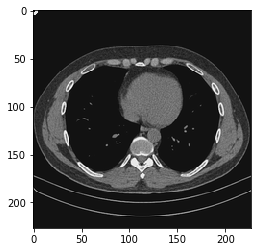

6
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


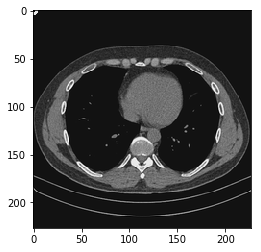

7
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


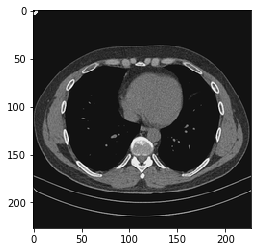

8
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


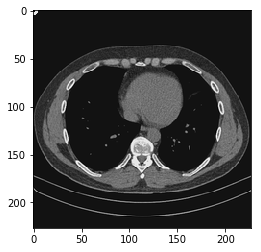

9
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


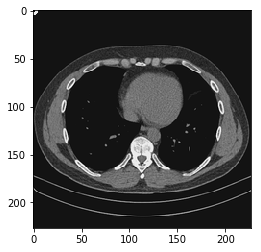

10
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


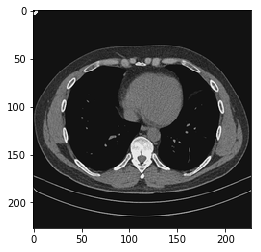

11
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


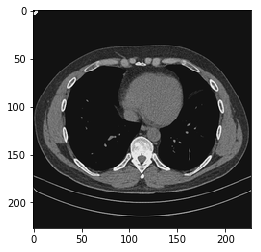

12
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


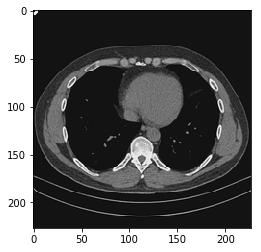

13
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


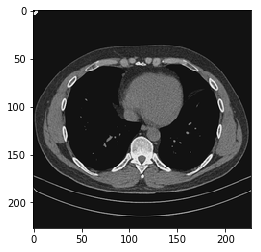

14
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


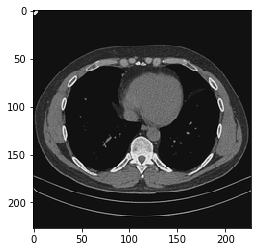

15
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


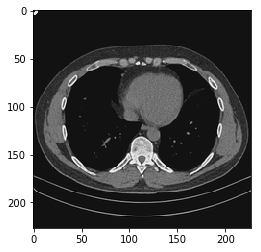

16
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


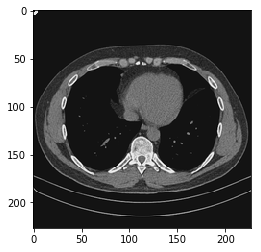

17
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


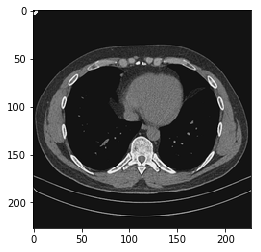

18
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


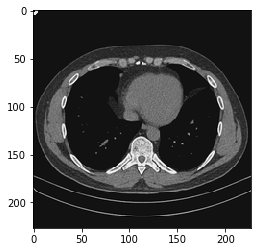

19
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


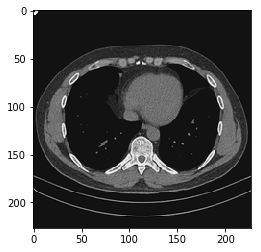

20
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


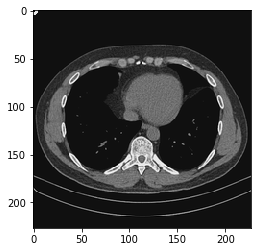

21
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


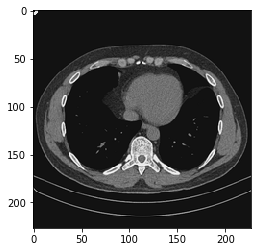

22
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


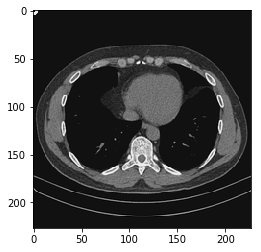

23
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


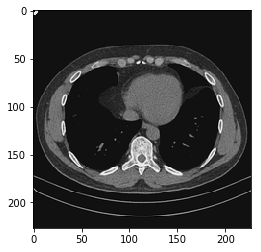

24
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


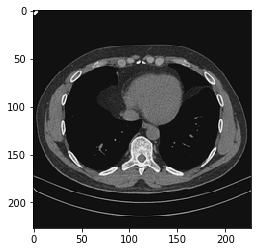

25
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


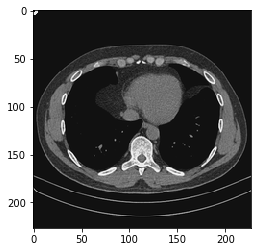

26
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


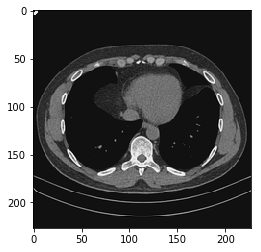

27
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


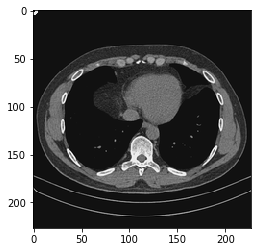

28
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


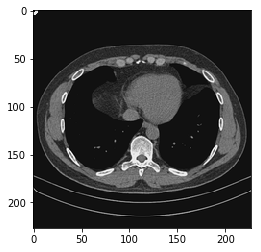

29
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


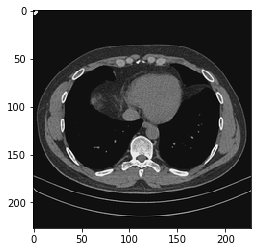

30
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


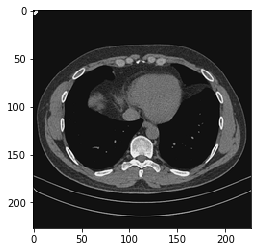

31
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


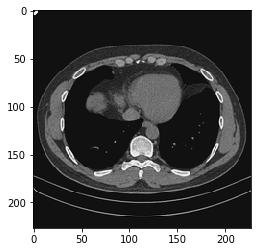

32
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


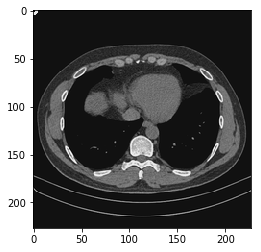

33
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


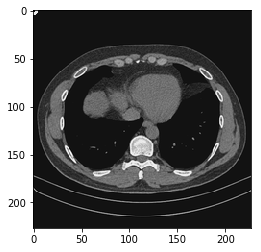

34
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


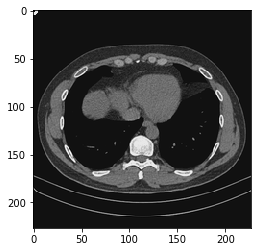

35
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


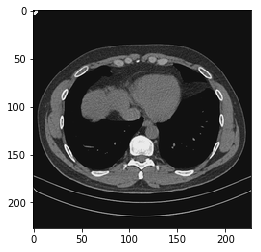

36
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


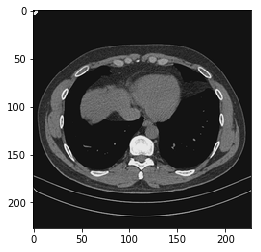

37
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


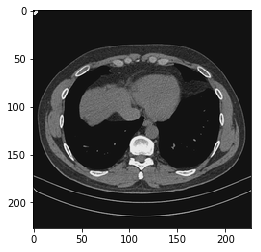

38
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


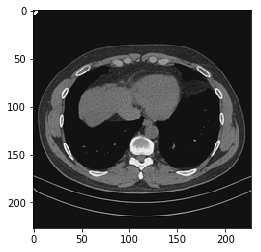

39
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


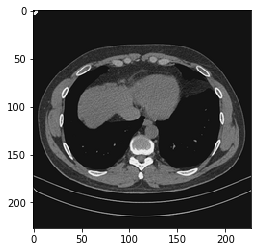

40
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


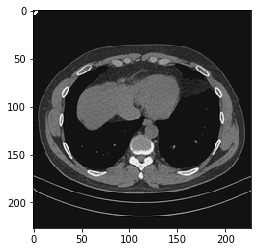

41
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


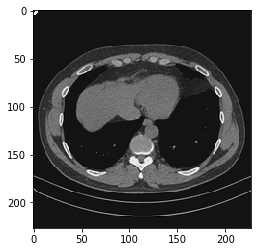

42
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


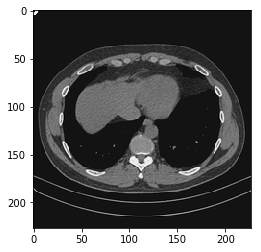

43
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


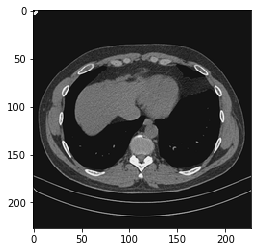

44
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


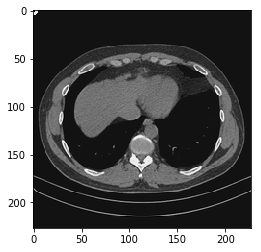

45
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


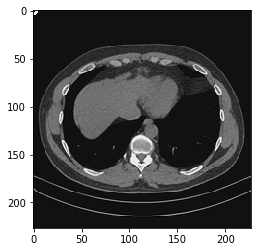

46
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


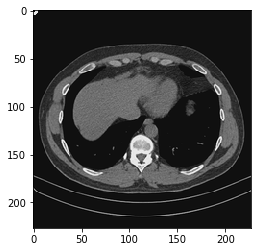

47
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


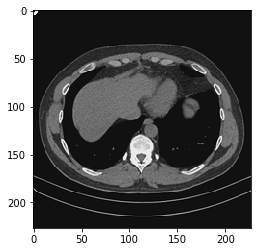

48
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


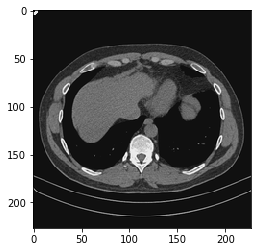

49
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


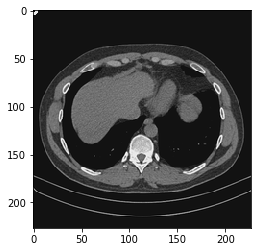

50
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


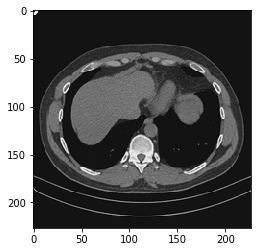

51
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


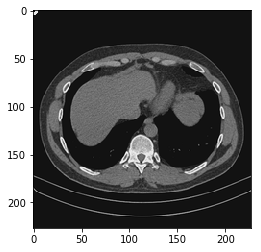

52
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


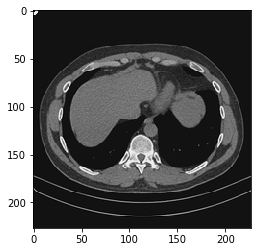

53
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


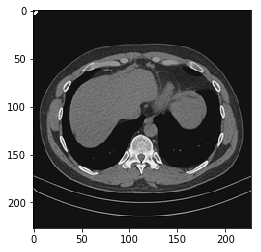

54
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


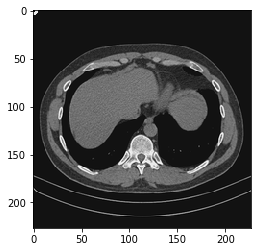

55
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


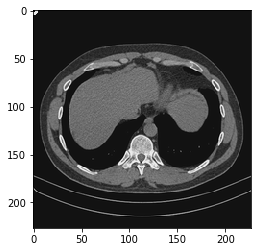

56
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


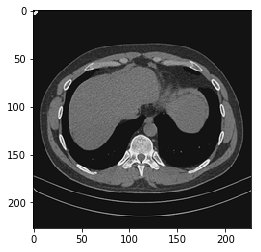

57
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


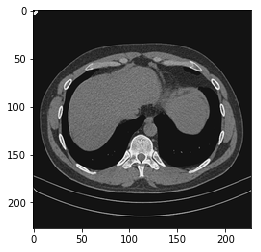

58
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


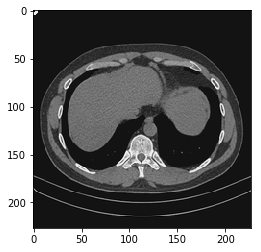

59
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


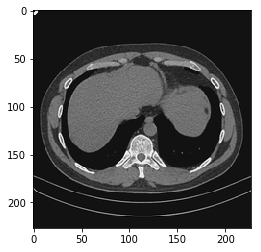

60
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


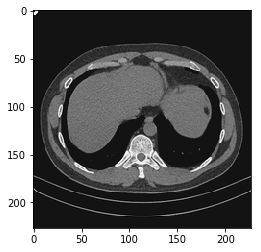

61
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


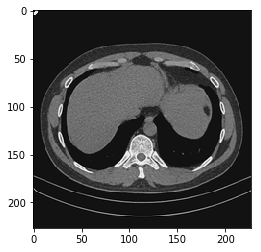

62
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


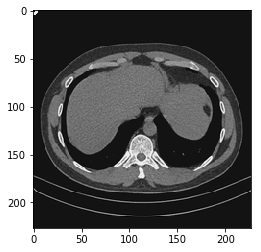

63
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


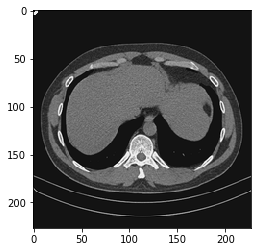

64
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


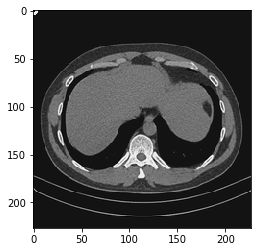

65
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


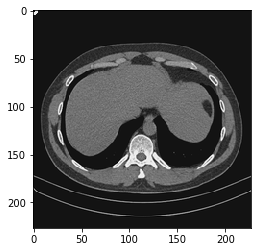

66
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


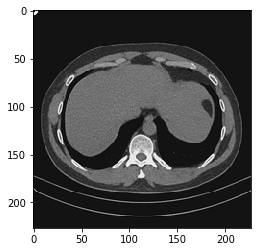

67
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


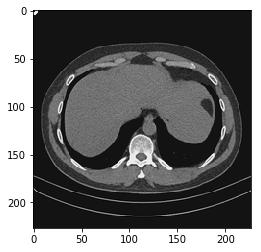

68
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


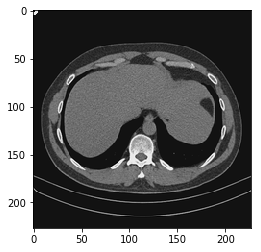

69
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


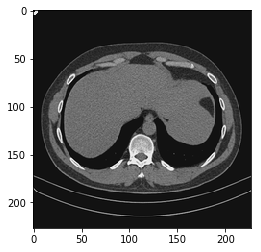

70
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


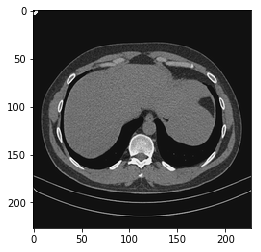

71
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


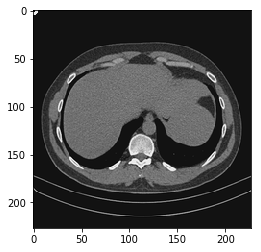

72
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


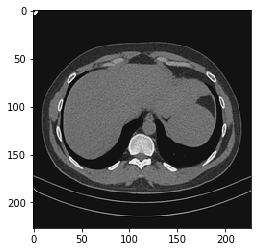

73
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


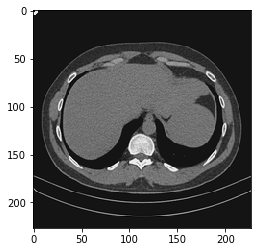

74
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


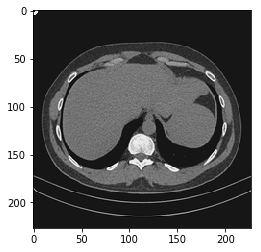

75
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


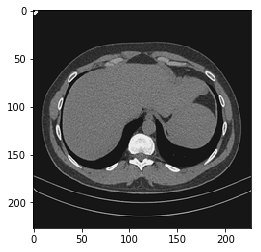

76
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


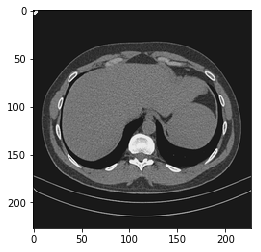

77
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


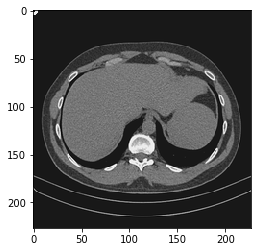

78
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


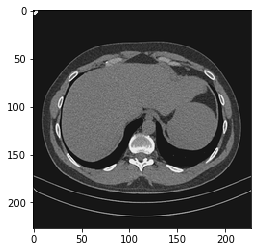

79
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


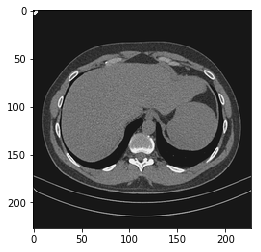

80
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


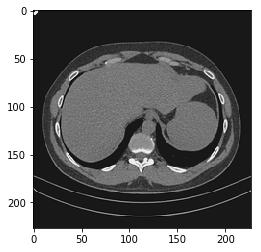

81
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


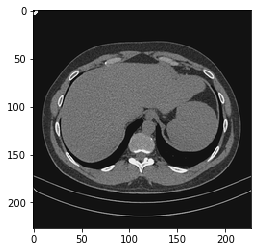

82
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


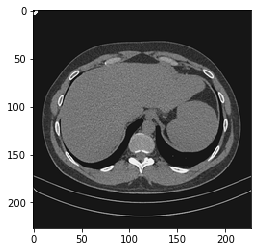

83
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


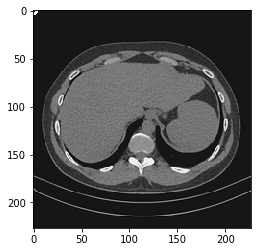

84
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


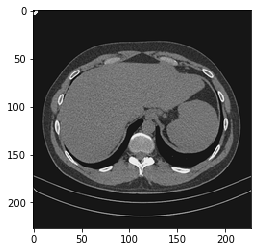

85
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


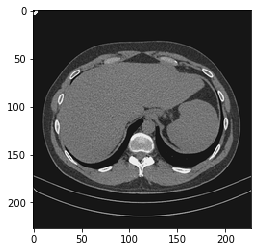

86
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


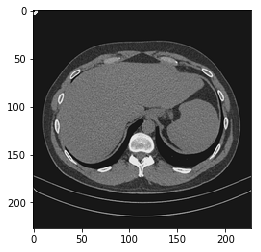

87
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


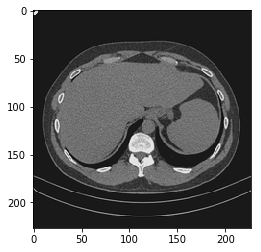

88
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


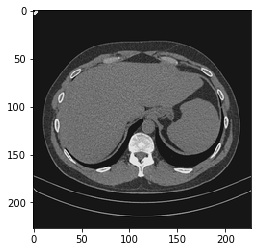

89
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


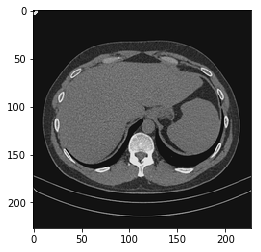

90
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


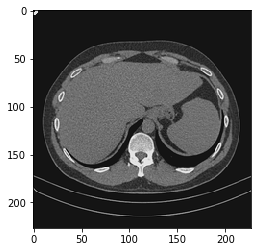

91
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


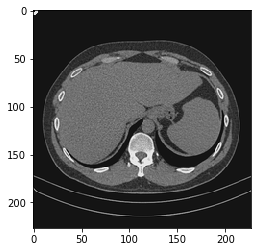

92
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


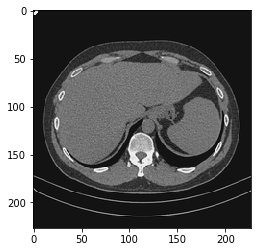

93
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


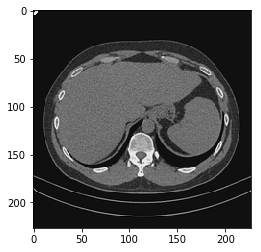

94
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


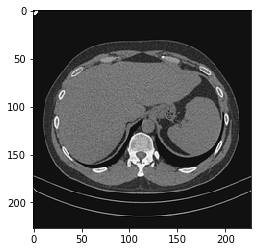

95
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


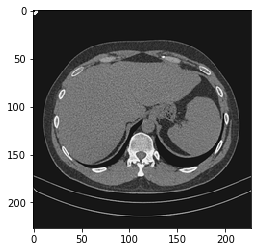

96
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


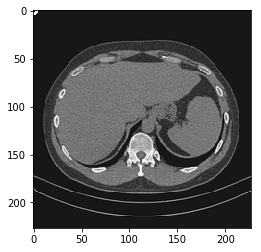

97
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


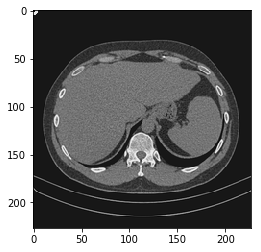

98
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


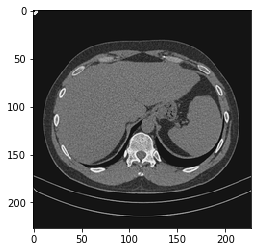

99
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


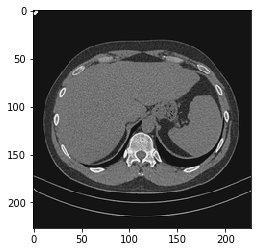

100
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


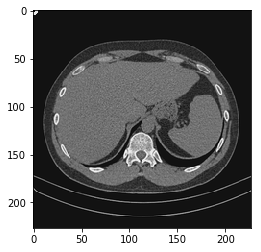

101
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


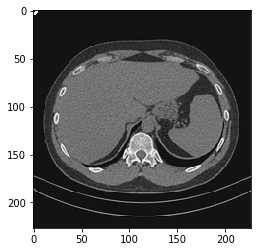

102
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


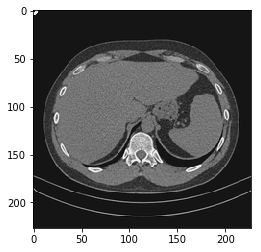

103
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


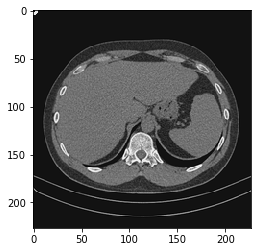

104
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


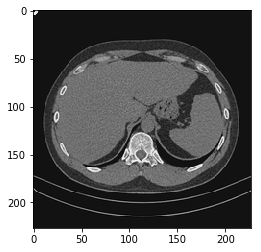

105
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


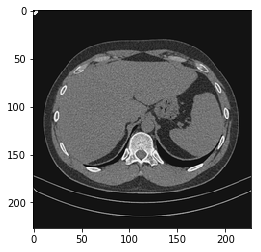

106
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


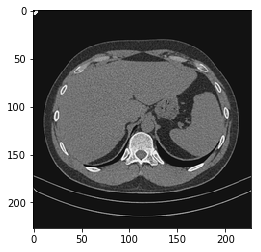

107
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


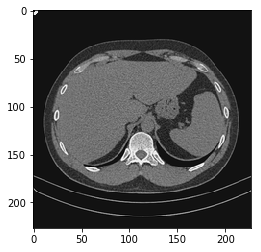

108
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


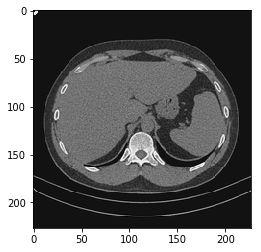

109
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


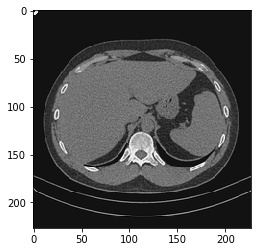

110
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


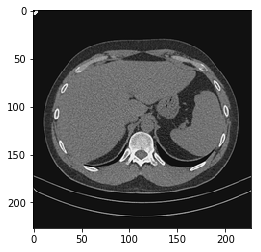

111
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


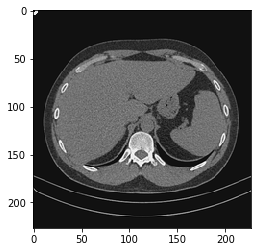

112
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


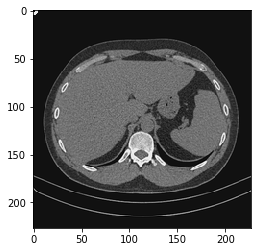

113
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


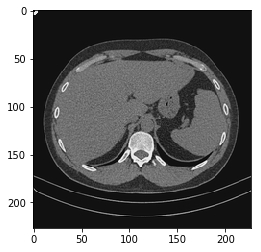

114
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


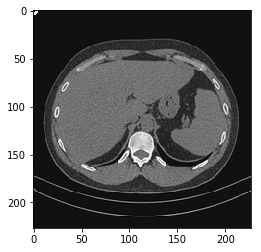

115
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


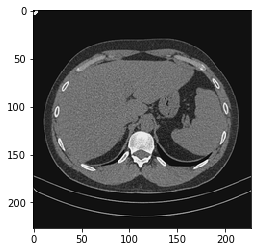

116
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


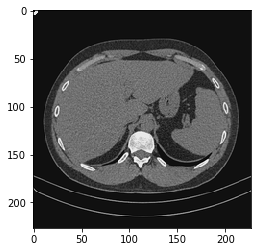

117
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


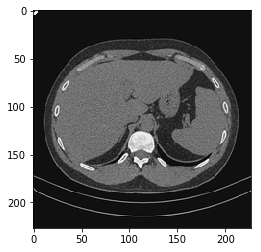

118
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


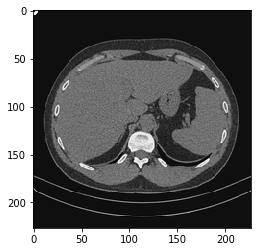

119
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


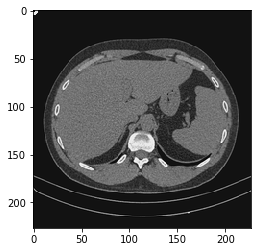

120
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


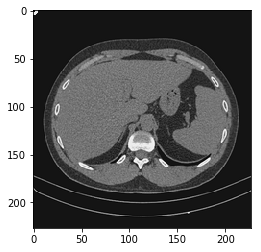

121
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


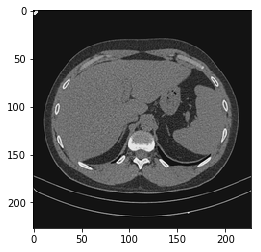

122
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


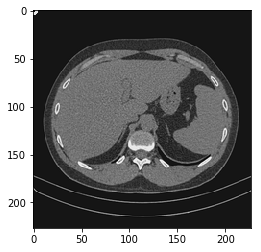

123
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


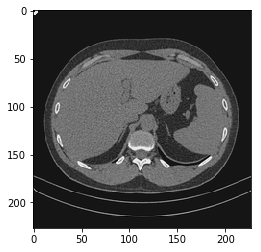

124
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


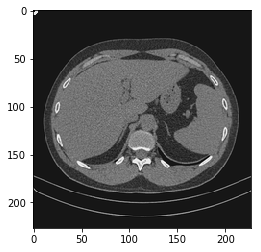

125
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


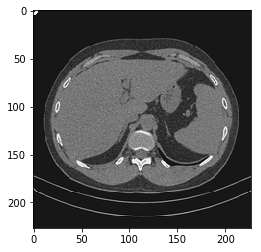

126
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


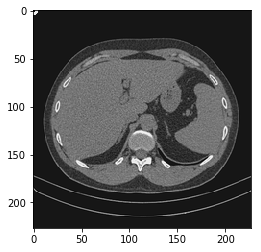

127
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


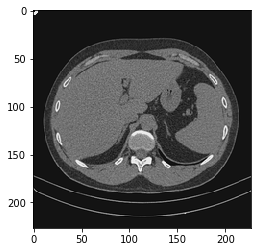

128
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


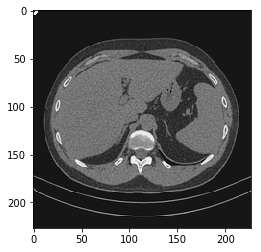

129
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


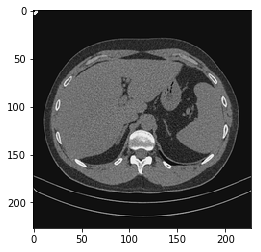

130
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


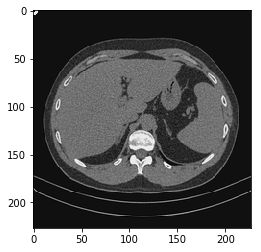

131
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


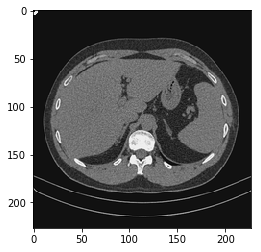

132
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


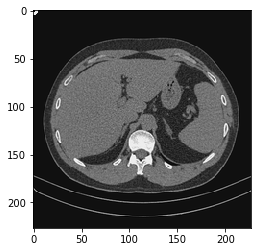

133
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


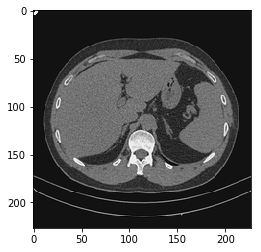

134
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


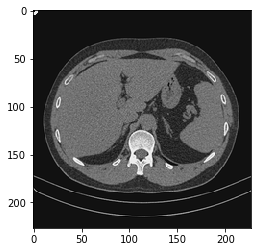

135
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


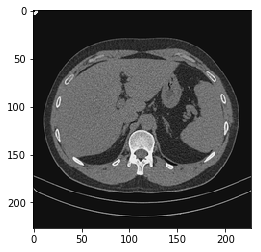

136
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


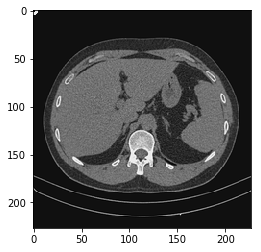

137
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


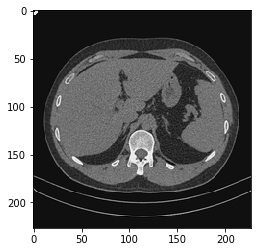

138
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


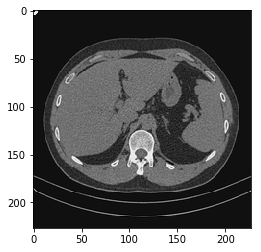

139
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


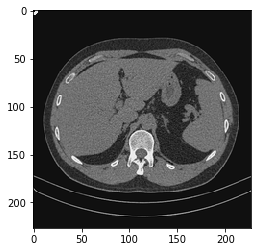

140
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


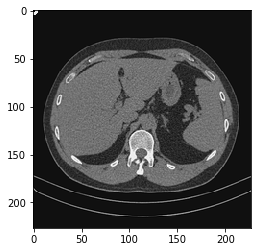

141
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


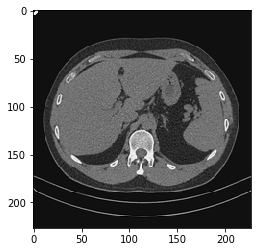

142
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


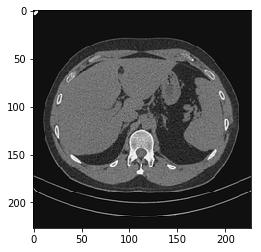

143
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


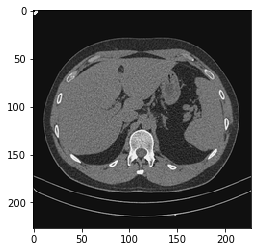

144
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


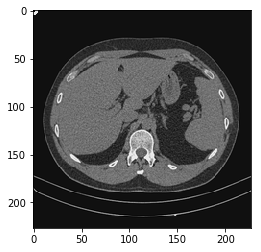

145
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


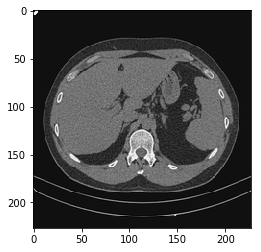

146
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


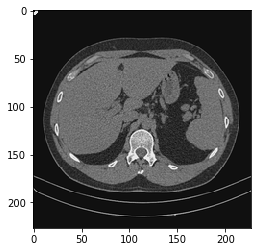

147
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


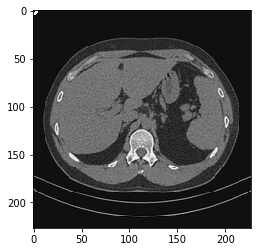

148
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


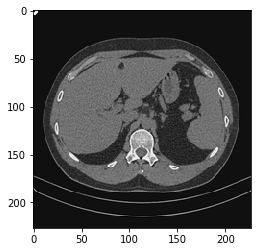

149
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


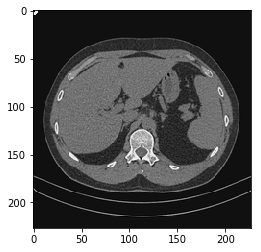

150
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


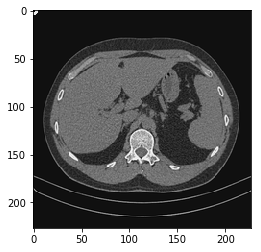

151
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


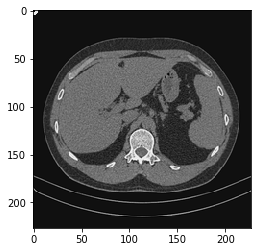

152
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


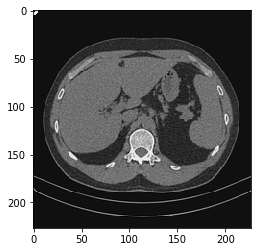

153
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


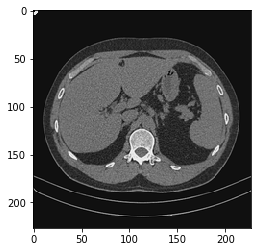

154
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


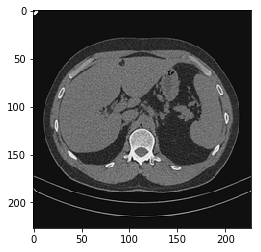

155
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


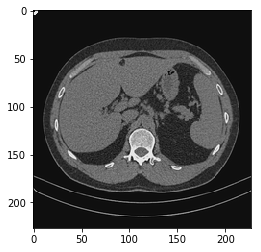

156
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


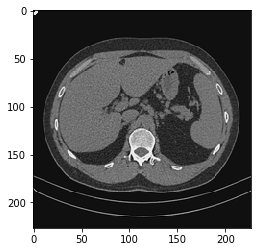

157
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


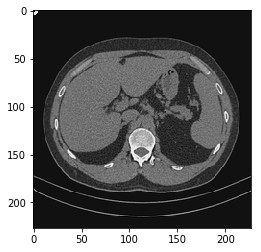

158
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


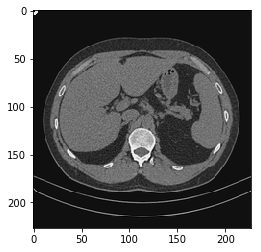

159
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


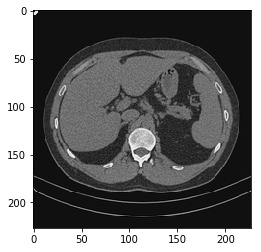

160
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


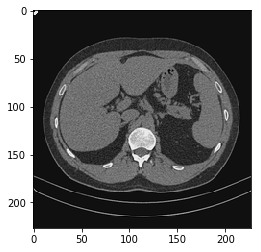

161
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


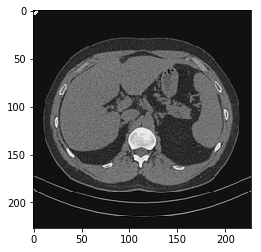

162
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


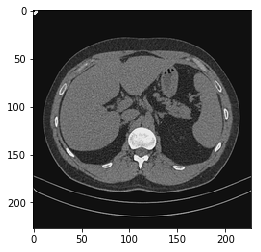

163
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


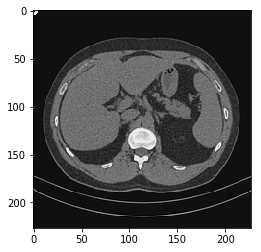

164
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


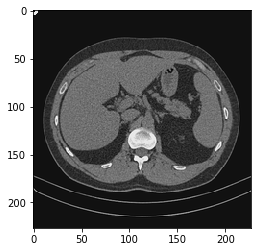

165
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


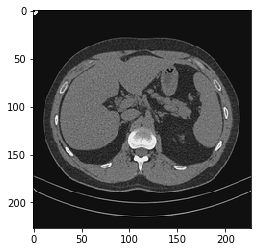

166
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


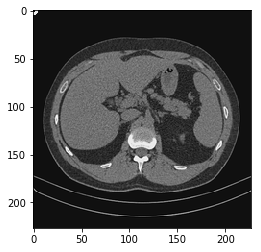

167
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


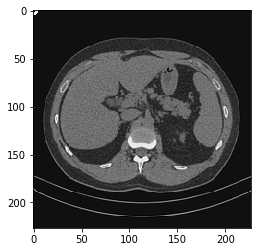

168
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


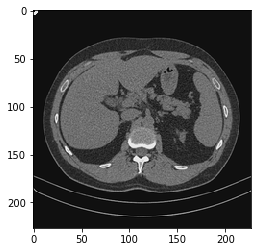

169
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


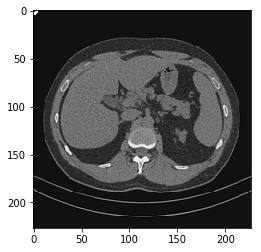

170
[[[0, 0], [0, 0]], array([[137.14583333, 127.6875    ],
       [165.52083333, 146.60416667]])]


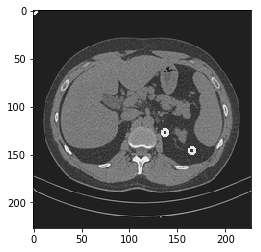

171
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


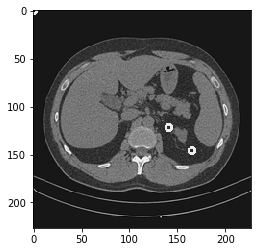

172
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


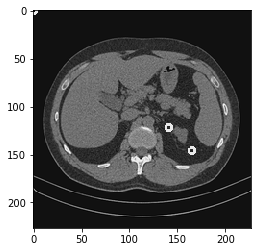

173
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


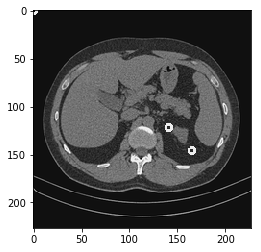

174
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


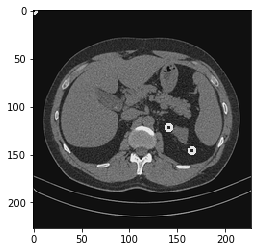

175
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


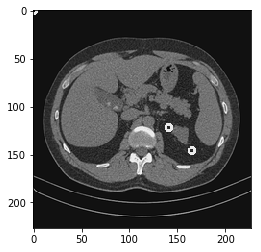

176
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


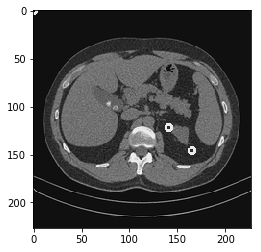

177
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


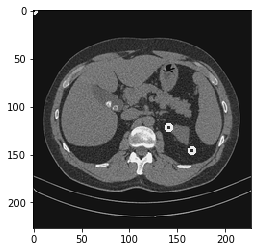

178
[[[0, 0], [0, 0]], array([[141.875     , 122.95833333],
       [165.52083333, 146.60416667]])]


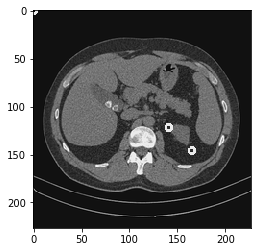

179
[[[0, 0], [0, 0]], array([[137.14583333, 122.95833333],
       [165.52083333, 146.60416667]])]


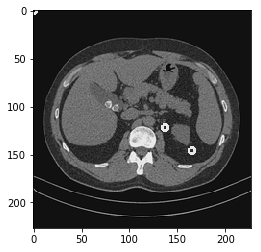

180
[[[0, 0], [0, 0]], array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


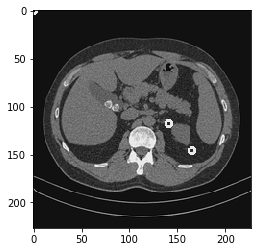

181
[array([[ 75.66666667, 122.95833333],
       [ 89.85416667, 151.33333333]]), array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


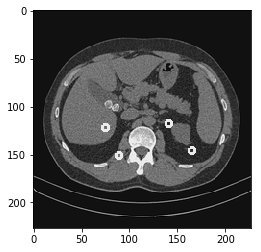

182
[[[0, 0], [0, 0]], array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


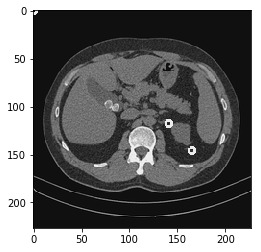

183
[array([[ 75.66666667, 122.95833333],
       [ 89.85416667, 146.60416667]]), array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


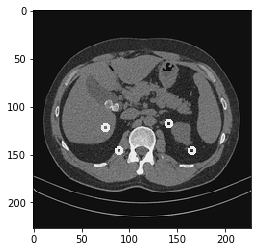

184
[array([[ 75.66666667, 122.95833333],
       [ 89.85416667, 141.875     ]]), array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


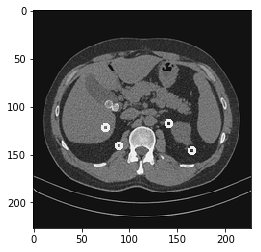

185
[array([[ 75.66666667, 122.95833333],
       [ 89.85416667, 141.875     ]]), array([[141.875     , 118.22916667],
       [165.52083333, 146.60416667]])]


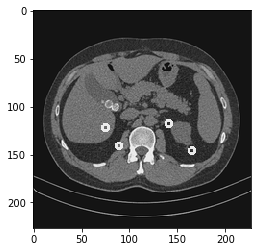

186
[array([[ 70.9375    , 118.22916667],
       [ 89.85416667, 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


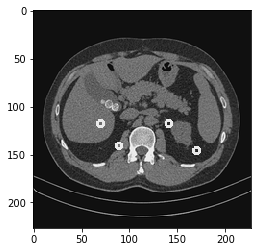

187
[array([[ 75.66666667, 122.95833333],
       [ 89.85416667, 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


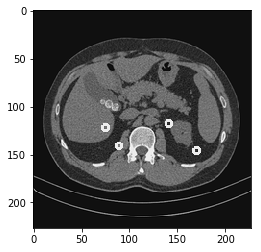

188
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


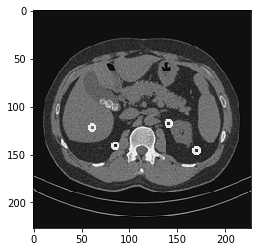

189
[array([[ 61.47916667, 122.95833333],
       [ 89.85416667, 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


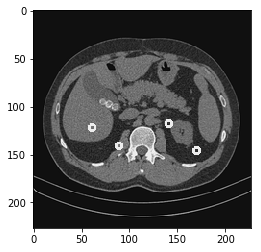

190
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


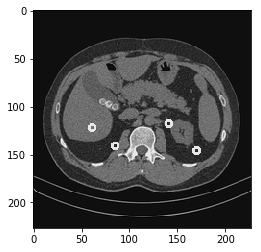

191
[array([[ 70.9375    , 122.95833333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


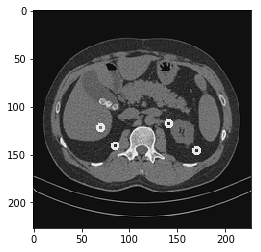

192
[array([[ 61.47916667, 118.22916667],
       [ 85.125     , 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


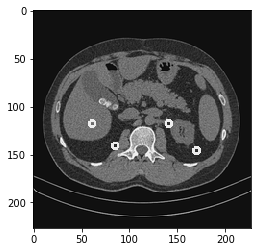

193
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 118.22916667],
       [170.25      , 146.60416667]])]


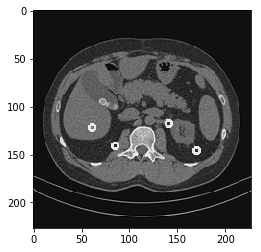

194
[array([[ 61.47916667, 122.95833333],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 118.22916667],
       [174.97916667, 146.60416667]])]


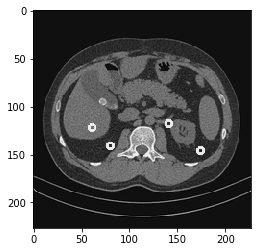

195
[array([[ 61.47916667, 122.95833333],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


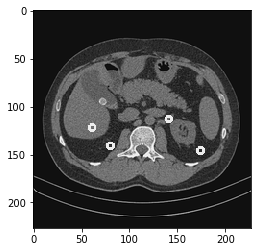

196
[array([[ 61.47916667, 122.95833333],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 118.22916667],
       [174.97916667, 146.60416667]])]


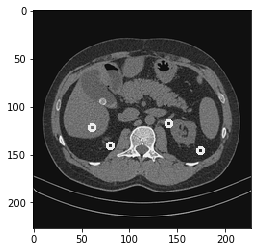

197
[[[0, 0], [0, 0]], array([[141.875     , 118.22916667],
       [174.97916667, 146.60416667]])]


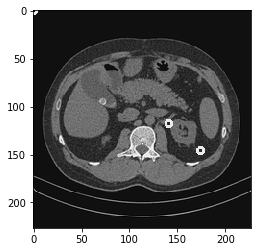

198
[array([[ 61.47916667, 122.95833333],
       [ 75.66666667, 141.875     ]]), array([[141.875     , 118.22916667],
       [174.97916667, 146.60416667]])]


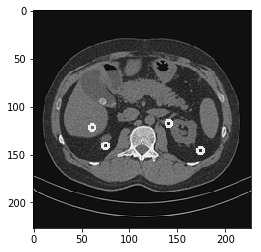

199
[array([[ 61.47916667, 122.95833333],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 118.22916667],
       [174.97916667, 146.60416667]])]


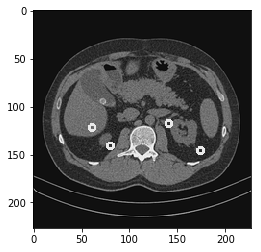

200
[array([[ 61.47916667, 122.95833333],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


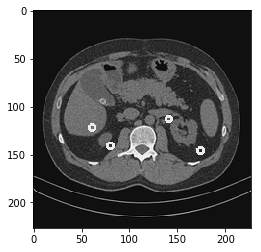

201
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


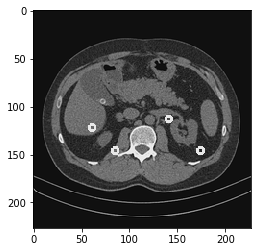

202
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


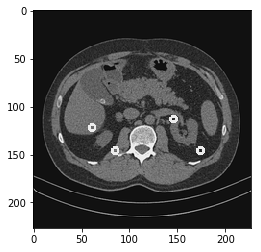

203
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


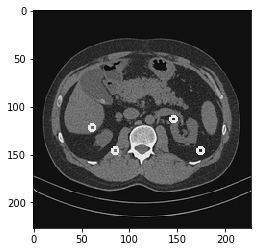

204
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


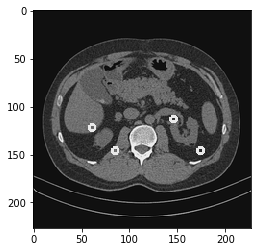

205
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


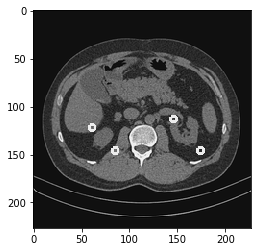

206
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


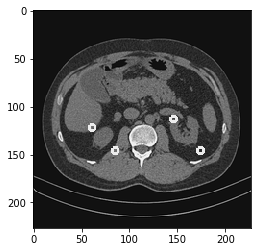

207
[array([[ 61.47916667, 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


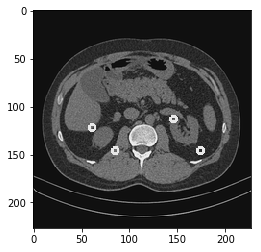

208
[array([[ 56.75      , 122.95833333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


Exception tensorflow.python.framework.errors_impl.CancelledError: (None, None, 'Session has been closed.') in <bound method _Callable.__del__ of <tensorflow.python.client.session._Callable object at 0x7f4c9dfc2590>> ignored


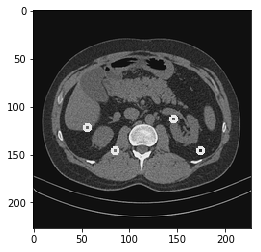

209
[array([[ 56.75      , 122.95833333],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


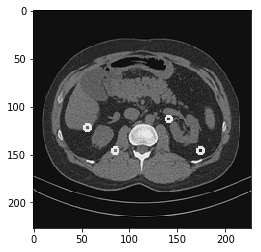

210
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


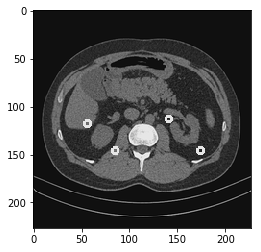

211
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [179.70833333, 146.60416667]])]


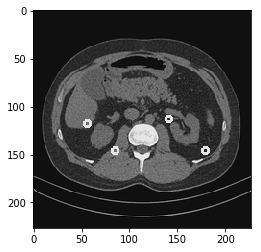

212
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [179.70833333, 146.60416667]])]


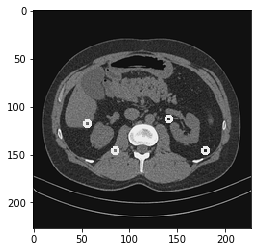

213
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [174.97916667, 146.60416667]])]


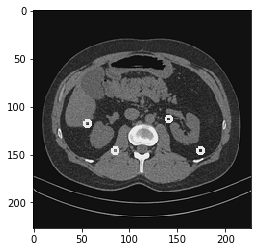

214
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


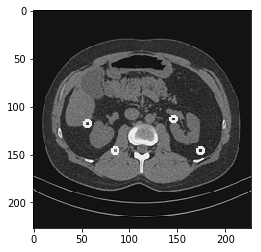

215
[array([[ 56.75      , 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


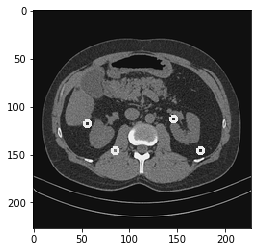

216
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


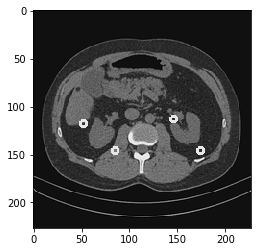

217
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


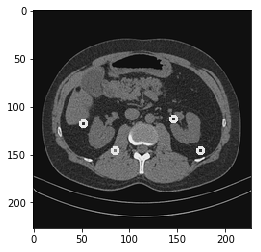

218
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


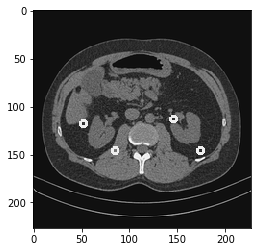

219
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 146.60416667]])]


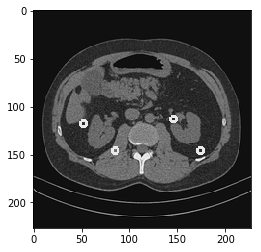

220
[array([[ 52.02083333, 113.5       ],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [179.70833333, 146.60416667]])]


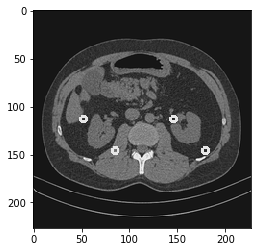

221
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [179.70833333, 141.875     ]])]


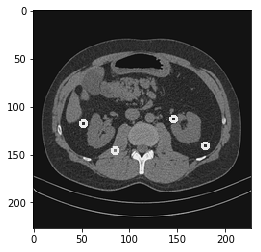

222
[array([[ 52.02083333, 118.22916667],
       [ 80.39583333, 151.33333333]]), array([[146.60416667, 113.5       ],
       [179.70833333, 146.60416667]])]


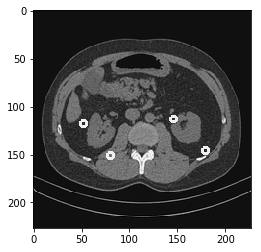

223
[array([[ 52.02083333, 118.22916667],
       [ 80.39583333, 151.33333333]]), array([[146.60416667, 113.5       ],
       [179.70833333, 146.60416667]])]


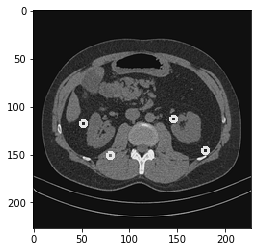

224
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 151.33333333]]), array([[146.60416667, 113.5       ],
       [179.70833333, 141.875     ]])]


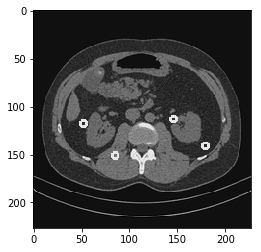

225
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [179.70833333, 146.60416667]])]


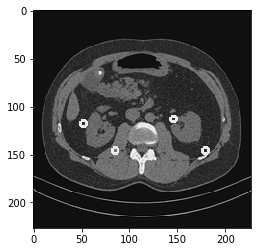

226
[array([[ 52.02083333, 118.22916667],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [179.70833333, 146.60416667]])]


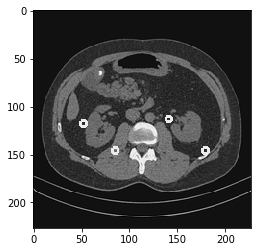

227
[array([[ 52.02083333, 113.5       ],
       [ 85.125     , 146.60416667]]), array([[141.875     , 113.5       ],
       [179.70833333, 146.60416667]])]


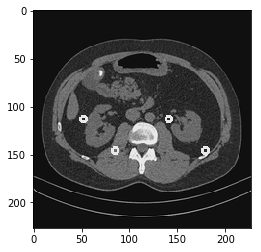

228
[array([[ 52.02083333, 113.5       ],
       [ 85.125     , 151.33333333]]), array([[141.875     , 113.5       ],
       [179.70833333, 146.60416667]])]


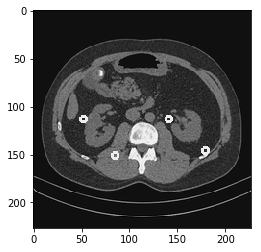

229
[array([[ 52.02083333, 108.77083333],
       [ 85.125     , 151.33333333]]), array([[141.875     , 113.5       ],
       [179.70833333, 141.875     ]])]


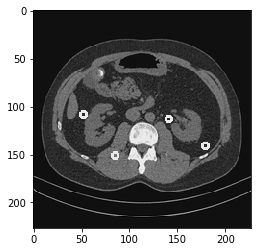

230
[array([[ 52.02083333, 108.77083333],
       [ 85.125     , 151.33333333]]), array([[141.875     , 113.5       ],
       [179.70833333, 141.875     ]])]


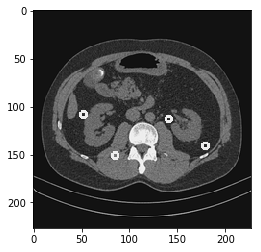

231
[array([[ 52.02083333, 108.77083333],
       [ 85.125     , 151.33333333]]), array([[141.875     , 113.5       ],
       [179.70833333, 141.875     ]])]


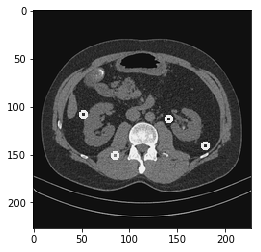

232
[array([[ 47.29166667, 108.77083333],
       [ 89.85416667, 146.60416667]]), array([[141.875     , 113.5       ],
       [179.70833333, 141.875     ]])]


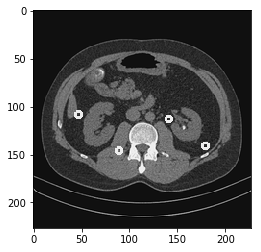

233
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [179.70833333, 141.875     ]])]


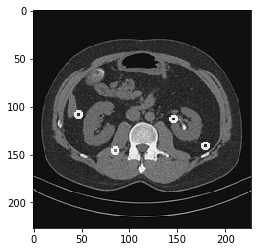

234
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[141.875     , 108.77083333],
       [179.70833333, 141.875     ]])]


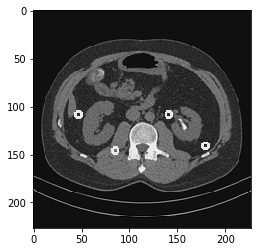

235
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 108.77083333],
       [179.70833333, 141.875     ]])]


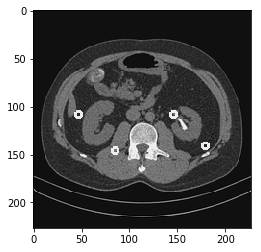

236
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[141.875     , 108.77083333],
       [179.70833333, 141.875     ]])]


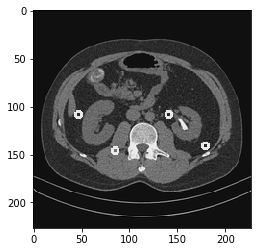

237
[array([[ 47.29166667, 108.77083333],
       [ 80.39583333, 146.60416667]]), array([[141.875     , 108.77083333],
       [174.97916667, 141.875     ]])]


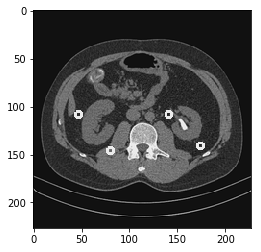

238
[array([[ 47.29166667, 108.77083333],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 108.77083333],
       [174.97916667, 141.875     ]])]


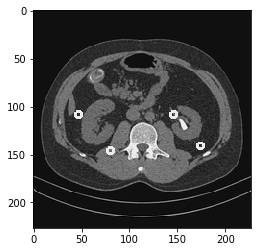

239
[array([[ 47.29166667, 108.77083333],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 141.875     ]])]


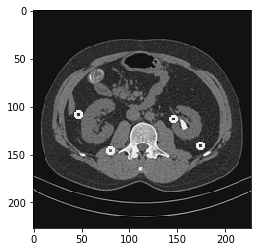

240
[array([[ 47.29166667, 108.77083333],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


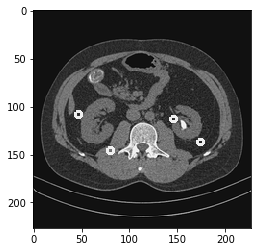

241
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


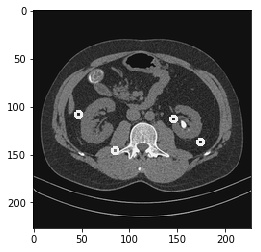

242
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


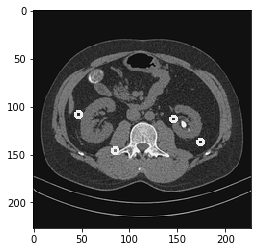

243
[array([[ 47.29166667, 108.77083333],
       [ 85.125     , 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


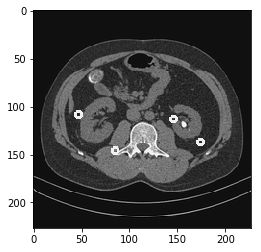

244
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


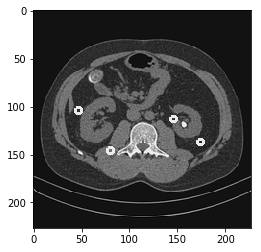

245
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


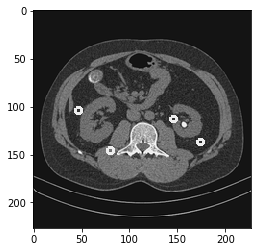

246
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


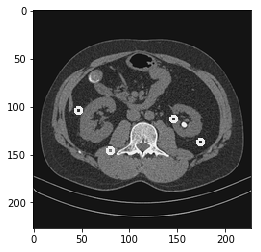

247
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), array([[146.60416667, 113.5       ],
       [174.97916667, 137.14583333]])]


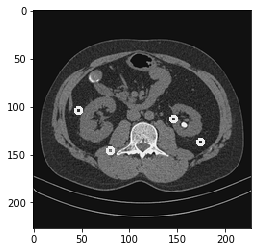

248
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), array([[141.875     , 108.77083333],
       [179.70833333, 137.14583333]])]


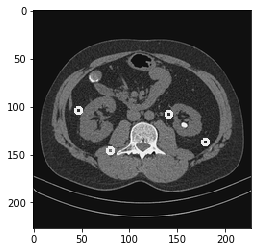

249
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), [[0, 0], [0, 0]]]


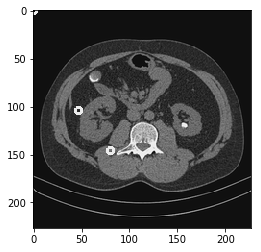

250
[array([[ 47.29166667, 104.04166667],
       [ 80.39583333, 146.60416667]]), [[0, 0], [0, 0]]]


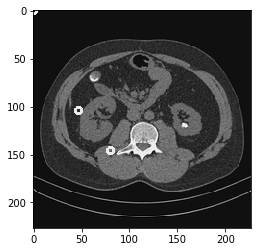

251
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 146.60416667]]), [[0, 0], [0, 0]]]


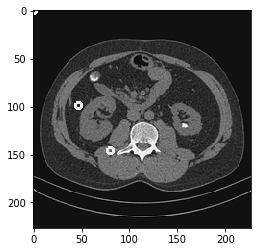

252
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 146.60416667]]), [[0, 0], [0, 0]]]


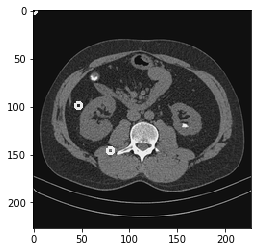

253
[array([[ 70.9375    , 122.95833333],
       [ 80.39583333, 146.60416667]]), [[0, 0], [0, 0]]]


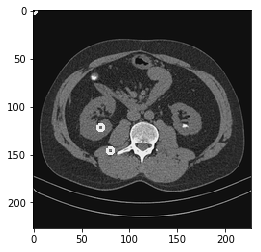

254
[array([[ 70.9375    , 122.95833333],
       [ 85.125     , 146.60416667]]), array([[141.875     , 108.77083333],
       [174.97916667, 137.14583333]])]


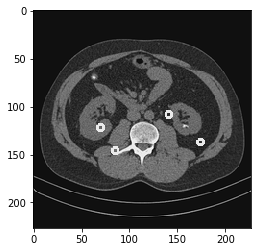

255
[array([[ 47.29166667,  94.58333333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 108.77083333],
       [179.70833333, 132.41666667]])]


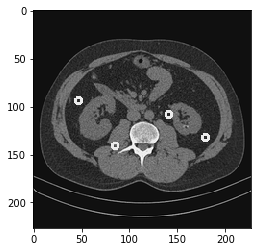

256
[array([[ 47.29166667,  99.3125    ],
       [ 85.125     , 141.875     ]]), array([[141.875     , 113.5       ],
       [174.97916667, 137.14583333]])]


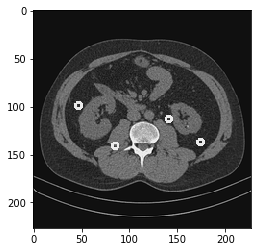

257
[array([[ 47.29166667,  94.58333333],
       [ 85.125     , 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 137.14583333]])]


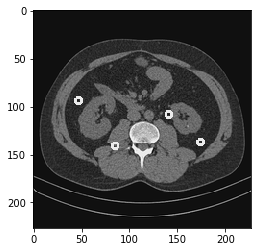

258
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


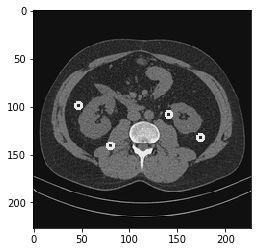

259
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


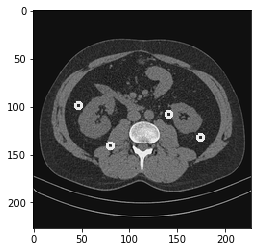

260
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


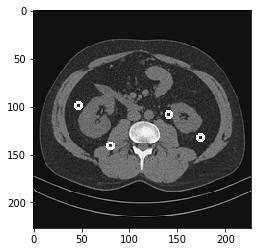

261
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


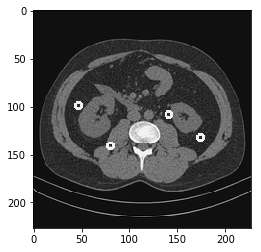

262
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


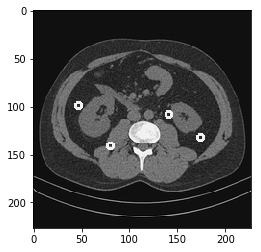

263
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


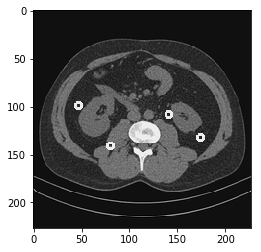

264
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 108.77083333],
       [174.97916667, 132.41666667]])]


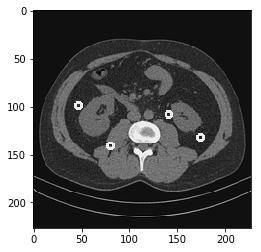

265
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 141.875     ]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


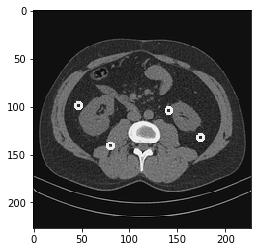

266
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 137.14583333]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


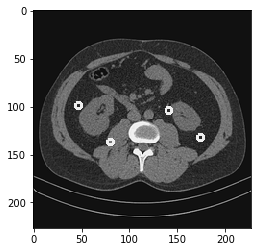

267
[array([[ 47.29166667,  99.3125    ],
       [ 80.39583333, 137.14583333]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


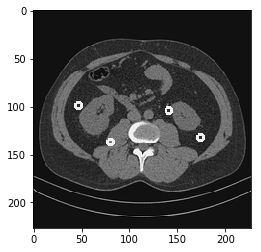

268
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 132.41666667]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


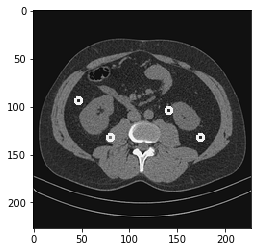

269
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 132.41666667]]), array([[137.14583333, 104.04166667],
       [174.97916667, 132.41666667]])]


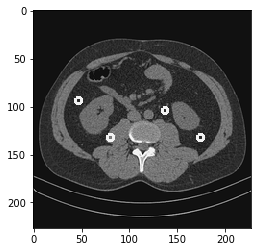

270
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 132.41666667]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


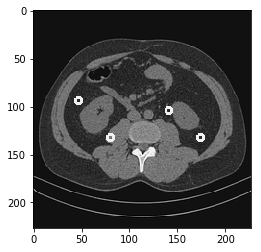

271
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 132.41666667]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


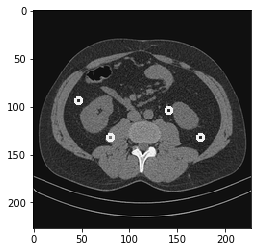

272
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 132.41666667]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


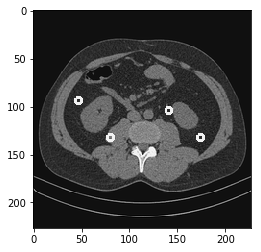

273
[array([[ 47.29166667,  94.58333333],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 132.41666667]])]


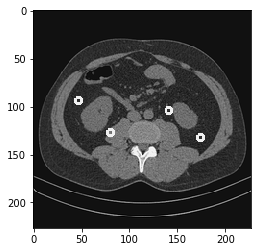

274
[array([[ 52.02083333,  94.58333333],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


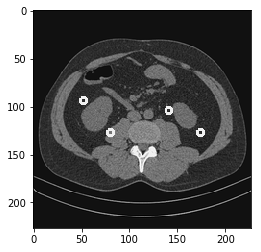

275
[array([[ 52.02083333,  94.58333333],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


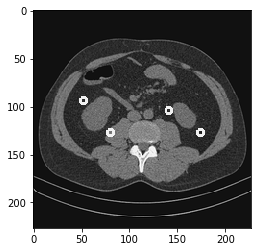

276
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


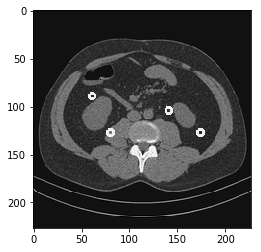

277
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


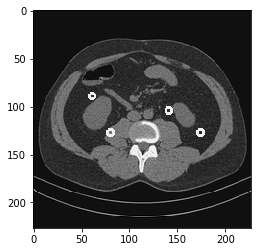

278
[array([[ 61.47916667,  89.85416667],
       [ 85.125     , 122.95833333]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


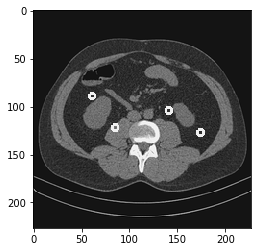

279
[array([[ 61.47916667,  89.85416667],
       [ 85.125     , 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


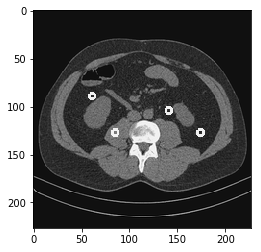

280
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


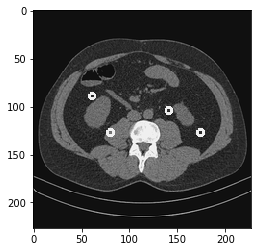

281
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 127.6875    ]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


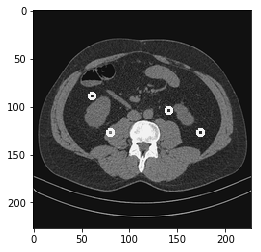

282
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 122.95833333]]), array([[141.875     , 104.04166667],
       [174.97916667, 127.6875    ]])]


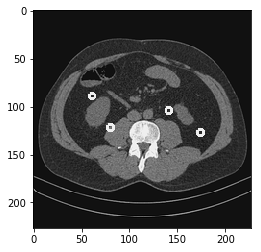

283
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 122.95833333]]), array([[146.60416667, 104.04166667],
       [174.97916667, 122.95833333]])]


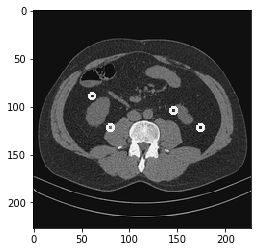

284
[array([[ 61.47916667,  89.85416667],
       [ 80.39583333, 122.95833333]]), array([[146.60416667,  99.3125    ],
       [174.97916667, 127.6875    ]])]


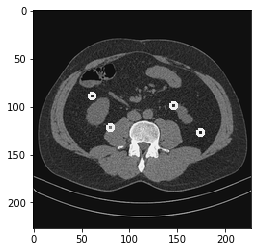

285
[array([[ 66.20833333,  94.58333333],
       [ 80.39583333, 122.95833333]]), [[0, 0], [0, 0]]]


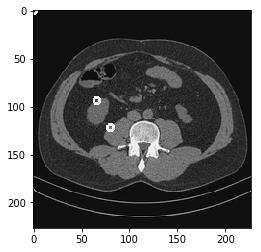

286
[array([[ 66.20833333,  99.3125    ],
       [ 80.39583333, 122.95833333]]), [[0, 0], [0, 0]]]


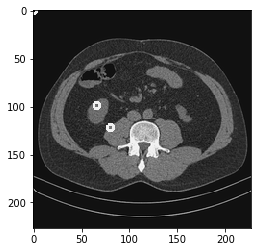

287
[array([[ 61.47916667,  94.58333333],
       [ 80.39583333, 122.95833333]]), [[0, 0], [0, 0]]]


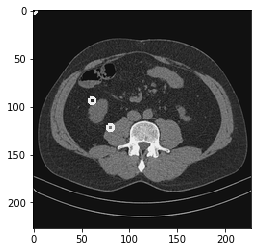

288
[array([[ 61.47916667,  94.58333333],
       [ 80.39583333, 118.22916667]]), [[0, 0], [0, 0]]]


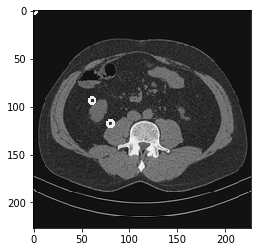

289
[array([[ 66.20833333, 104.04166667],
       [ 80.39583333, 118.22916667]]), [[0, 0], [0, 0]]]


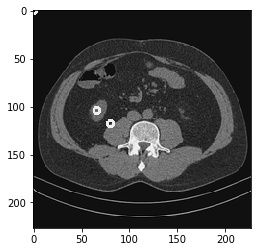

290
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


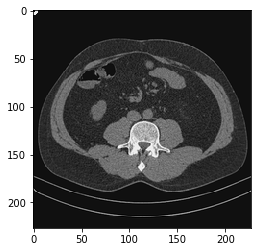

291
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


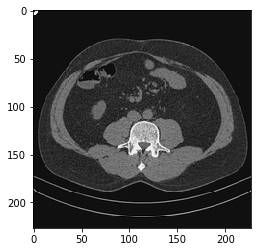

292
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


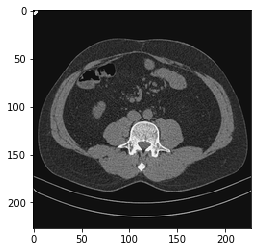

293
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


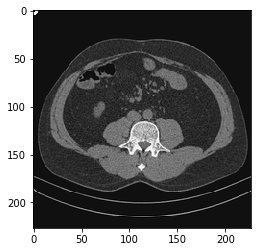

294
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


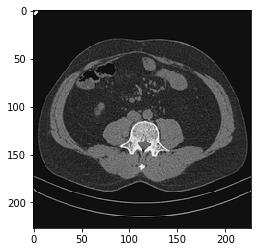

295
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


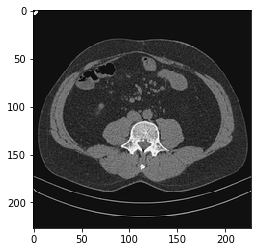

296
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


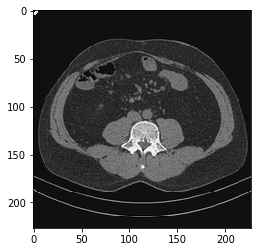

297
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


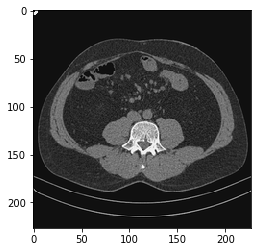

298
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


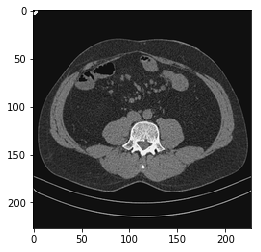

299
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


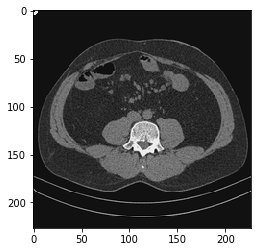

300
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


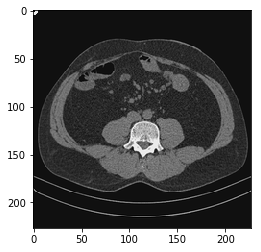

301
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


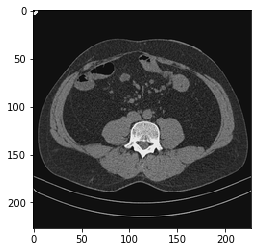

302
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


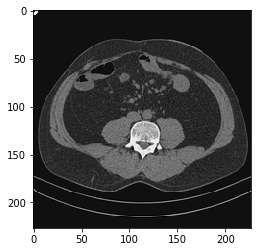

303
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


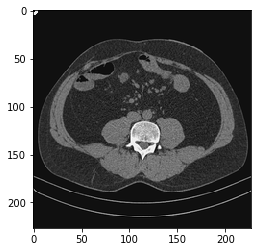

304
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


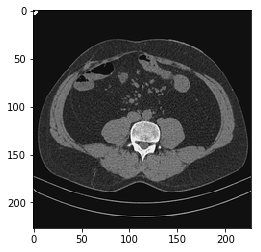

305
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


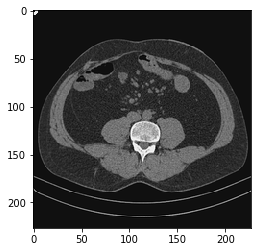

306
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


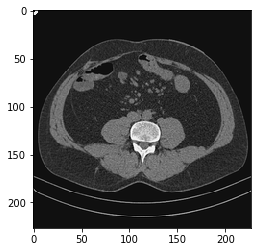

307
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


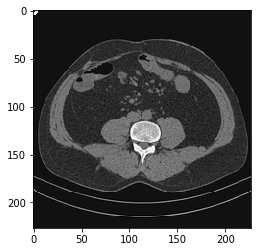

308
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


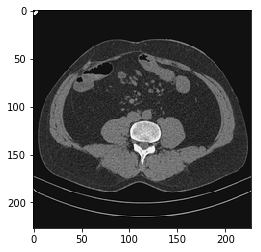

309
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


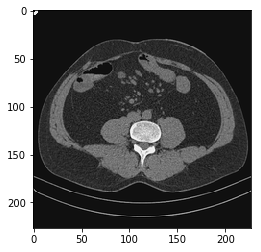

310
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


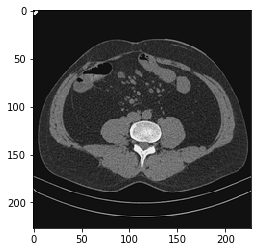

311
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


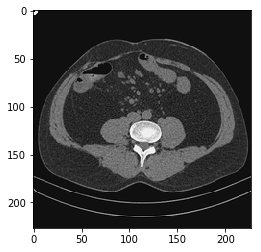

312
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


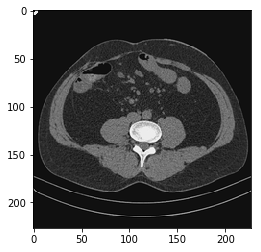

313
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


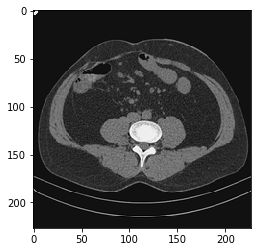

314
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


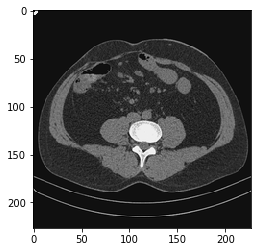

315
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


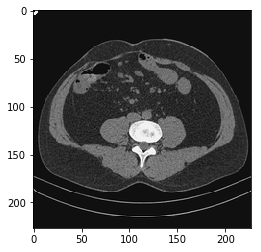

316
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


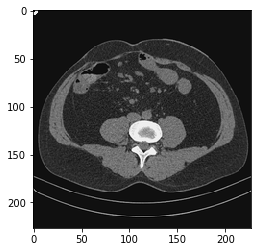

317
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


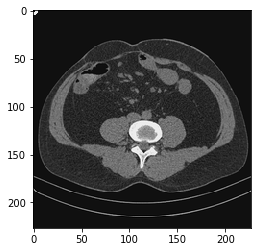

318
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


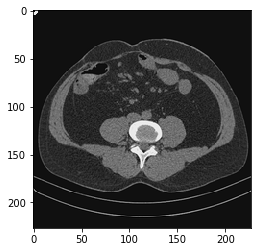

319
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


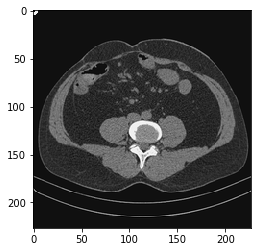

320
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


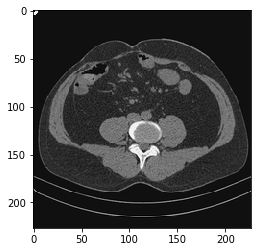

321
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


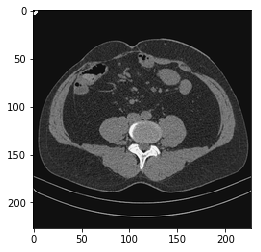

322
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


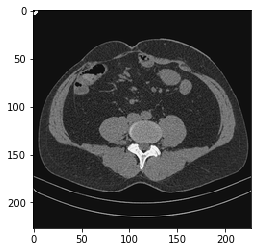

323
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


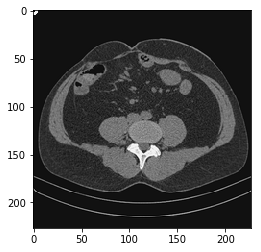

324
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 137.14583333]])]


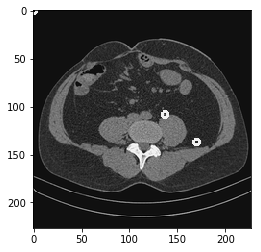

325
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


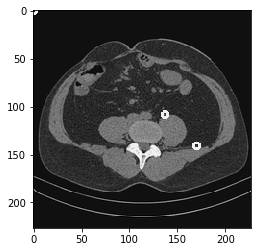

326
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


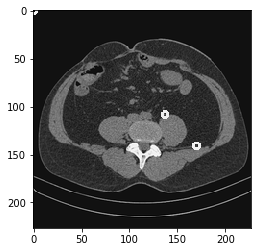

327
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


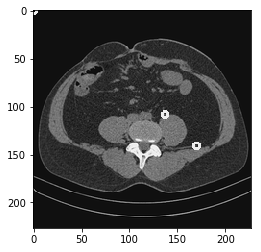

328
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


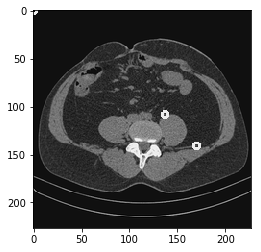

329
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


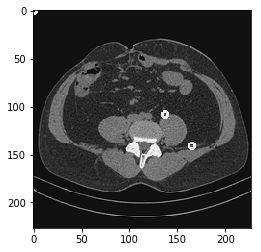

330
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


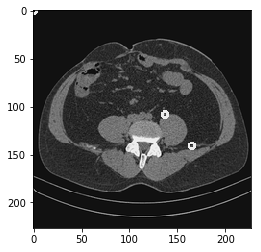

331
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


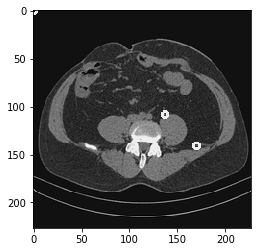

332
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


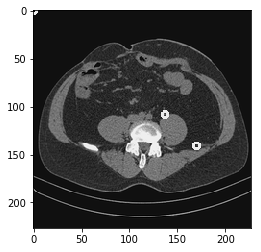

333
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


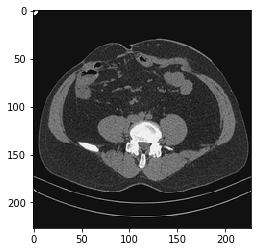

334
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


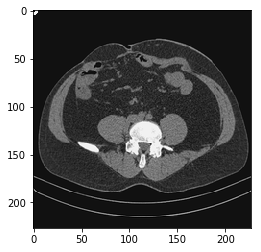

335
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


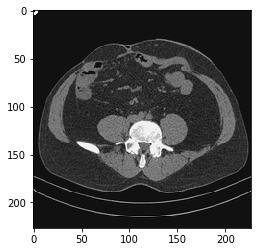

336
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [170.25      , 141.875     ]])]


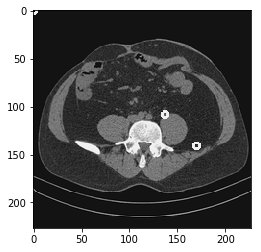

337
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


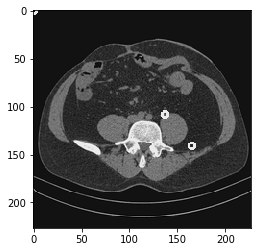

338
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


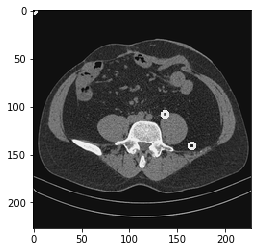

339
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


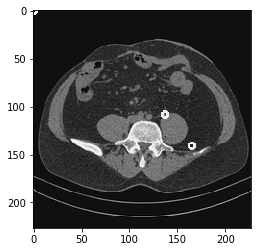

340
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


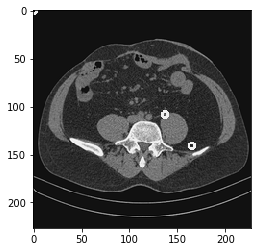

341
[array([[ 70.9375    , 108.77083333],
       [170.25      , 132.41666667]]), array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


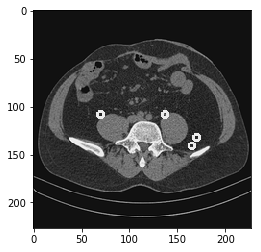

342
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


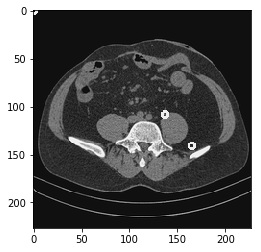

343
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


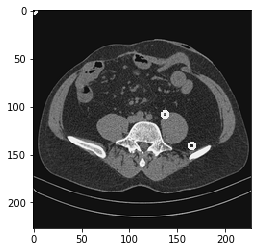

344
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


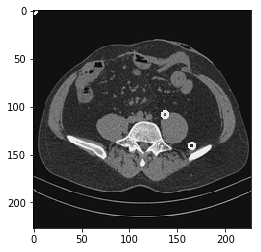

345
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [165.52083333, 141.875     ]])]


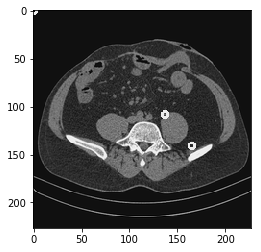

346
[[[0, 0], [0, 0]], array([[132.41666667, 108.77083333],
       [165.52083333, 141.875     ]])]


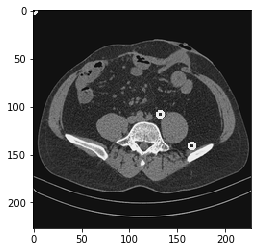

347
[[[0, 0], [0, 0]], array([[132.41666667, 108.77083333],
       [165.52083333, 141.875     ]])]


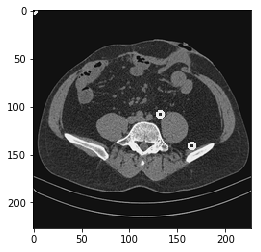

348
[[[0, 0], [0, 0]], array([[132.41666667, 108.77083333],
       [165.52083333, 141.875     ]])]


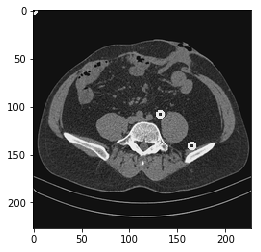

349
[[[0, 0], [0, 0]], array([[132.41666667, 108.77083333],
       [165.52083333, 141.875     ]])]


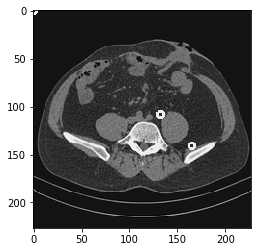

350
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [165.52083333, 141.875     ]])]


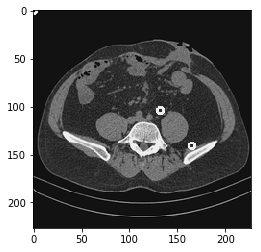

351
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [165.52083333, 141.875     ]])]


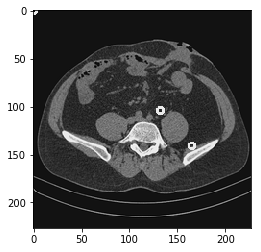

352
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [165.52083333, 141.875     ]])]


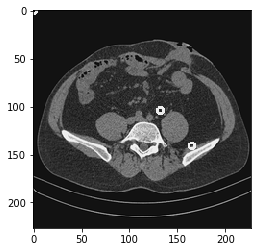

353
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [165.52083333, 141.875     ]])]


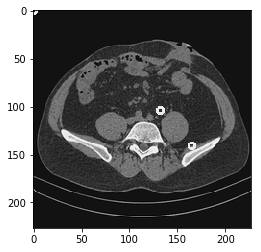

354
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [165.52083333, 141.875     ]])]


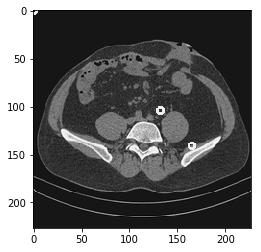

355
[[[0, 0], [0, 0]], array([[132.41666667, 104.04166667],
       [160.79166667, 141.875     ]])]


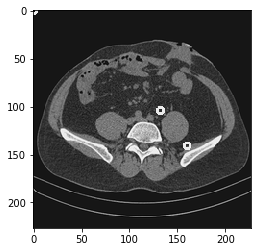

356
[[[0, 0], [0, 0]], array([[132.41666667, 108.77083333],
       [165.52083333, 137.14583333]])]


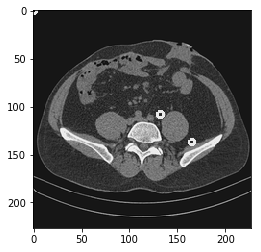

357
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


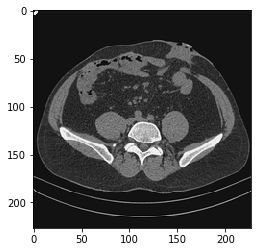

358
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


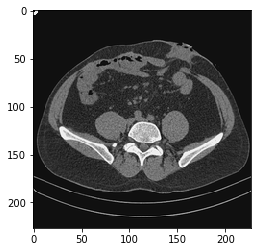

359
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


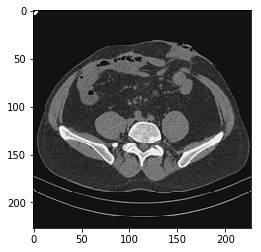

360
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


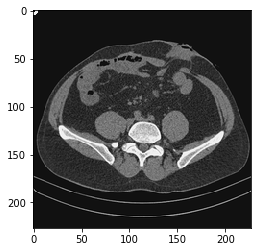

361
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


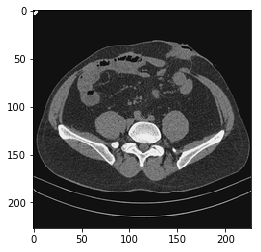

362
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


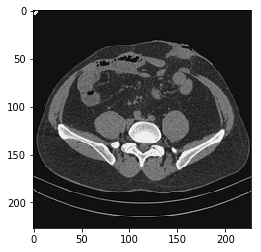

363
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


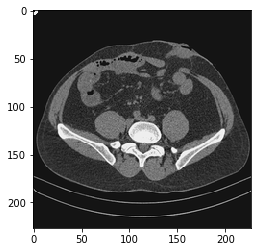

364
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


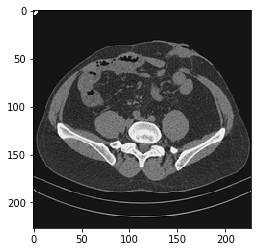

365
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


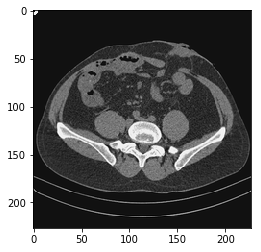

366
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


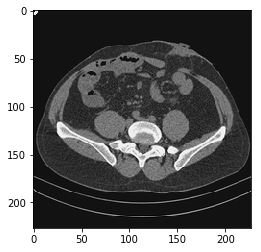

367
[[[0, 0], [0, 0]], array([[137.14583333, 108.77083333],
       [174.97916667, 137.14583333]])]


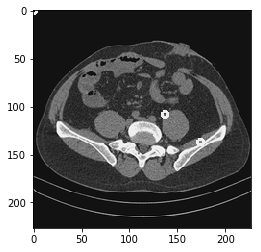

368
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


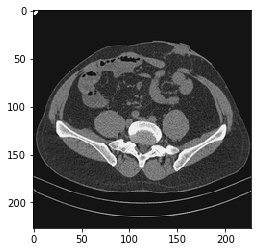

369
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


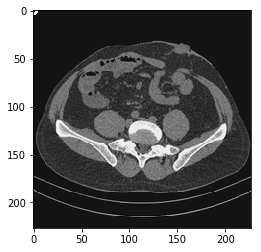

370
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


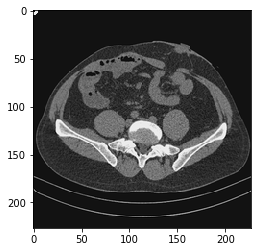

371
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


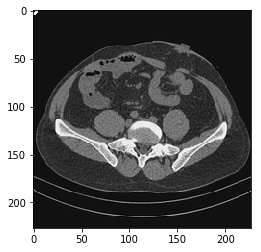

372
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


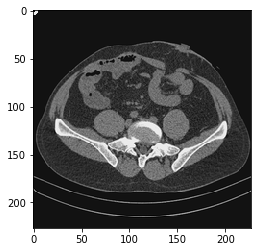

373
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


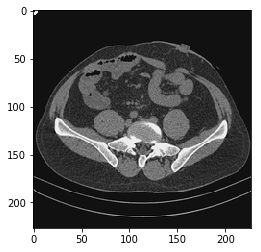

374
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


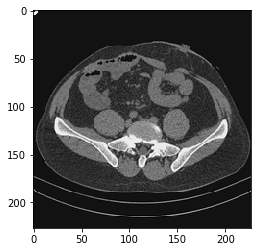

375
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


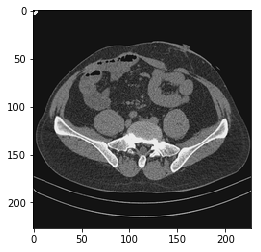

376
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


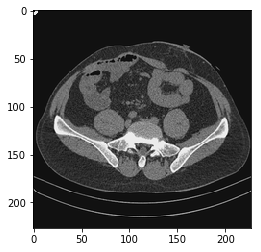

377
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


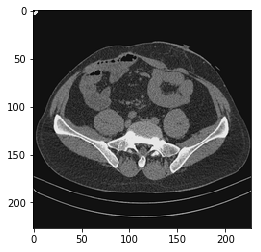

378
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


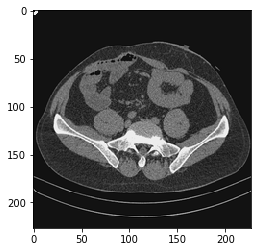

379
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


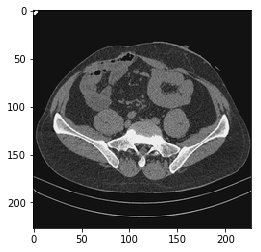

380
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


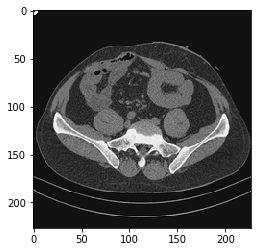

381
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


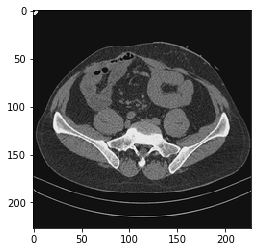

382
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


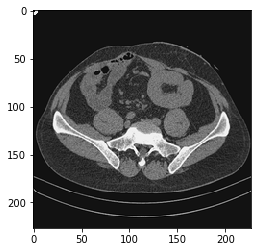

383
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


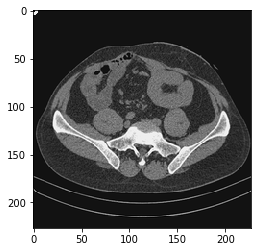

384
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


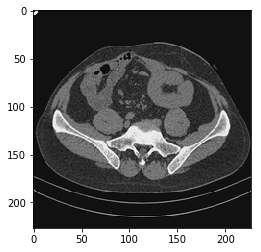

385
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


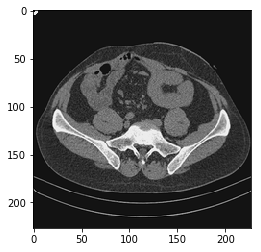

386
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


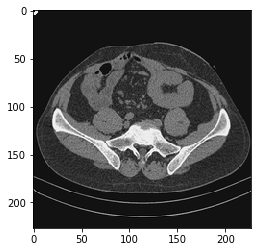

387
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


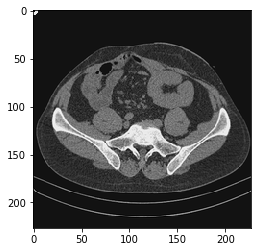

388
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


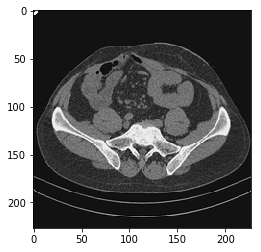

389
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


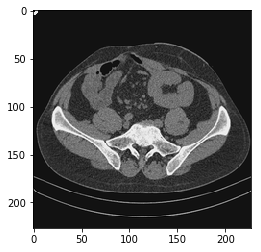

390
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


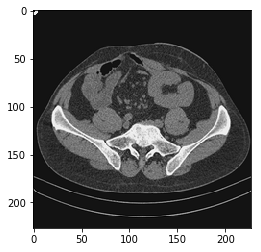

391
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


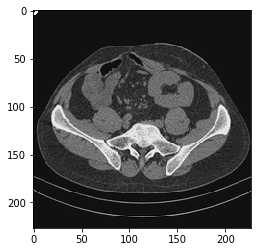

392
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


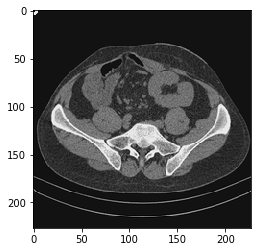

393
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


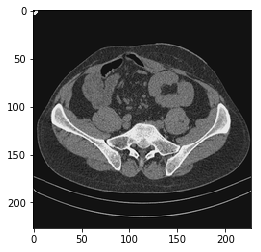

394
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


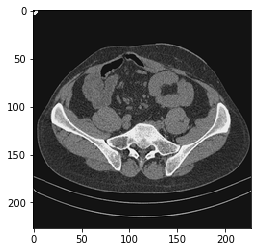

395
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


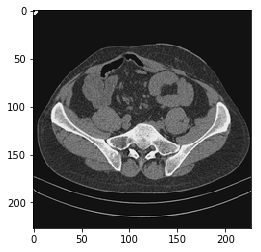

396
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


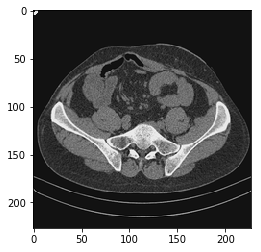

397
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


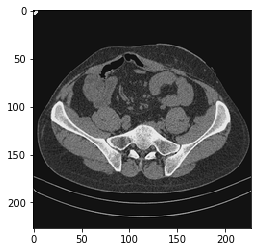

398
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


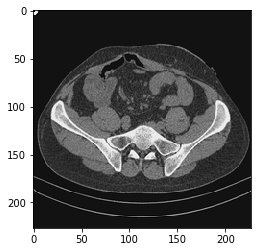

399
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


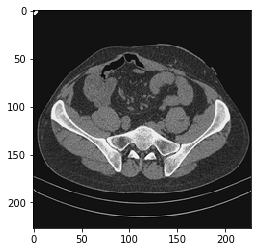

400
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


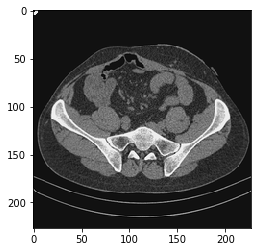

401
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


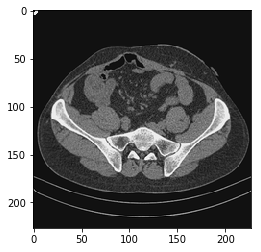

402
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


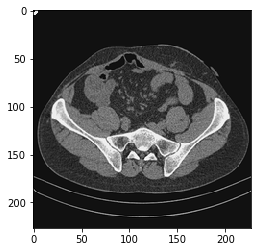

403
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


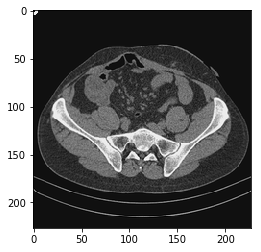

404
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


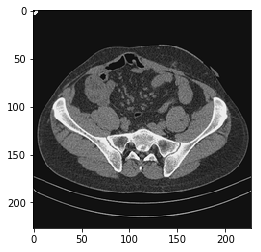

405
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


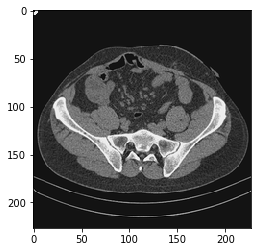

406
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


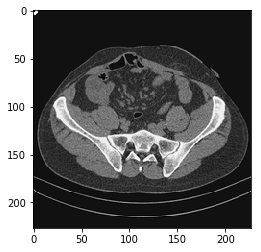

407
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


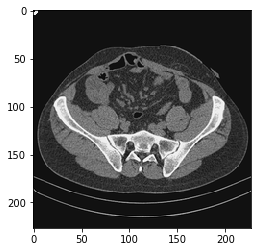

408
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


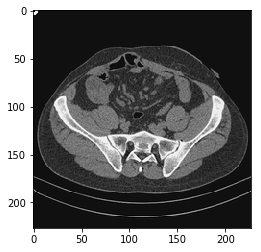

409
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


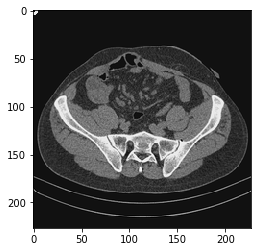

410
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


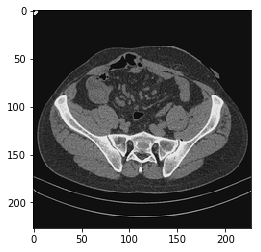

411
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


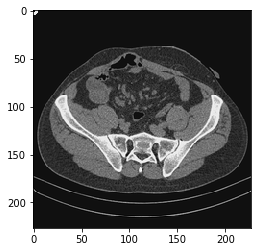

412
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


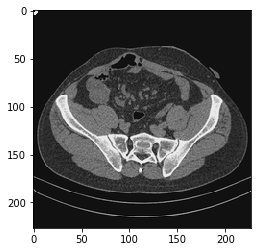

413
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


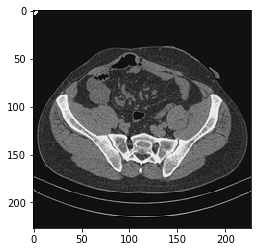

414
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


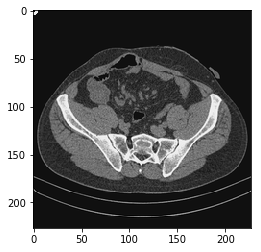

415
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


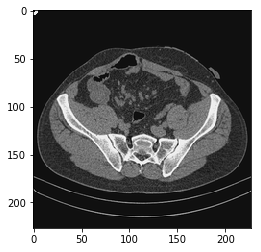

416
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


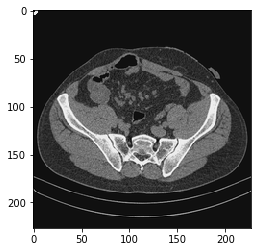

417
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


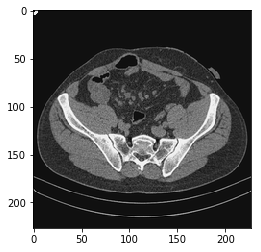

418
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


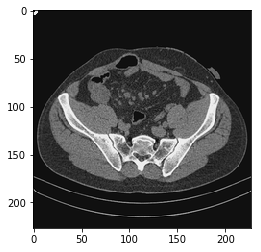

419
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


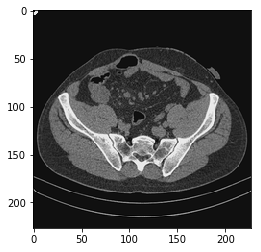

420
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


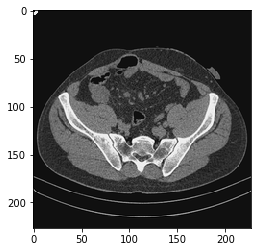

421
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


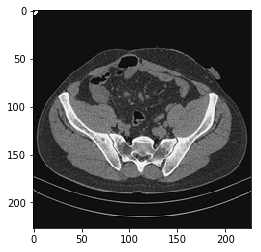

422
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


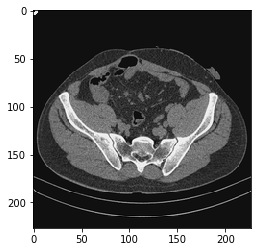

423
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


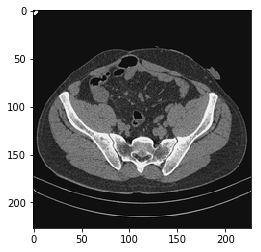

424
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


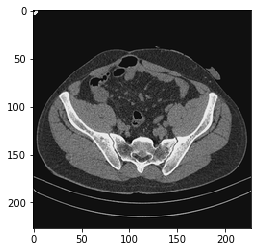

425
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


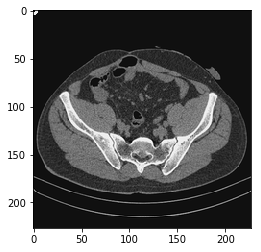

426
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


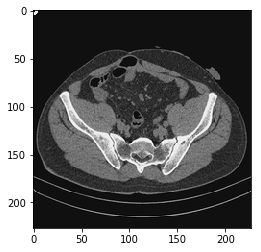

427
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


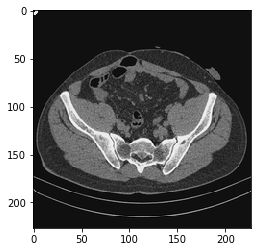

428
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


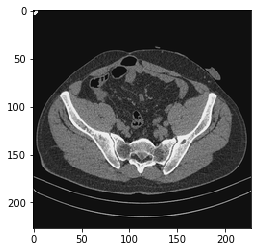

429
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


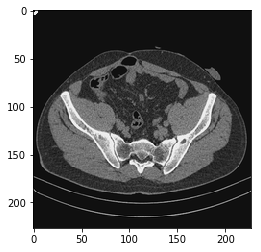

430
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


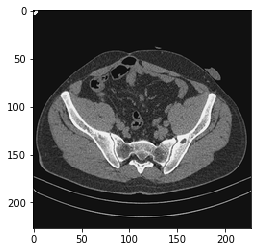

431
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


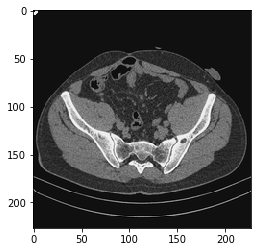

432
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


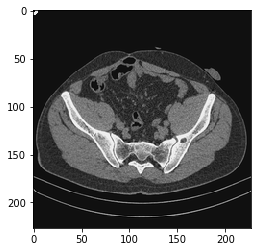

433
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


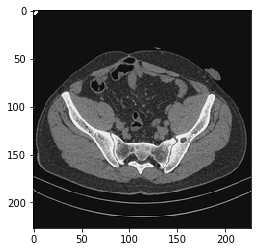

434
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


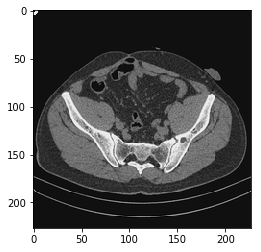

435
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


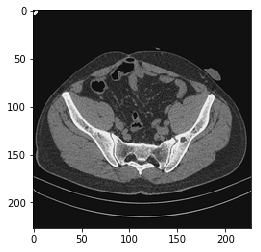

436
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


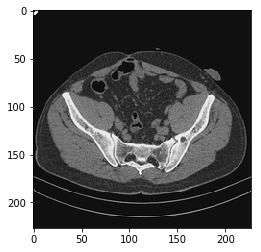

437
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


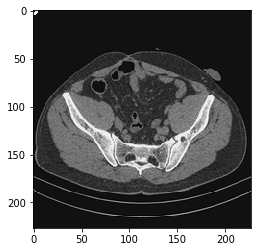

438
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


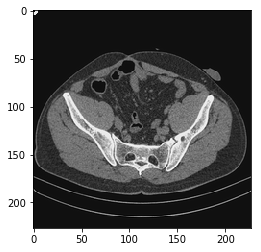

439
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


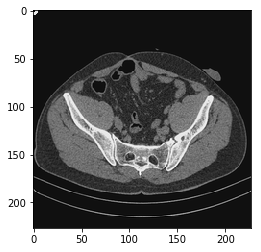

440
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


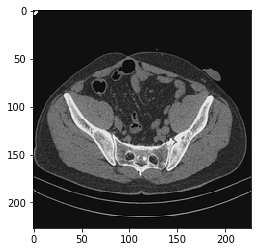

441
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


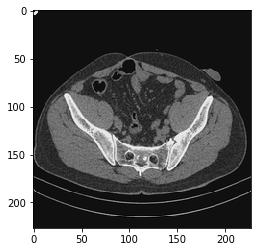

442
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


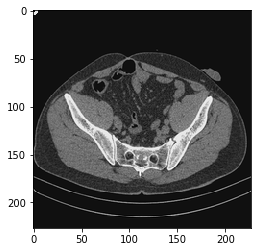

443
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


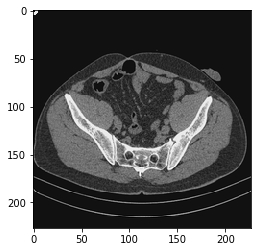

444
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


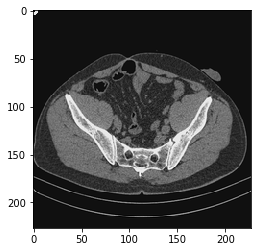

445
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


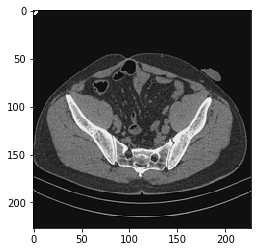

446
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


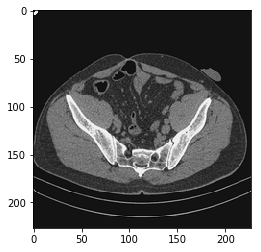

447
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


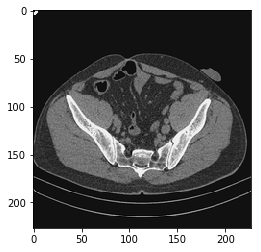

448
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


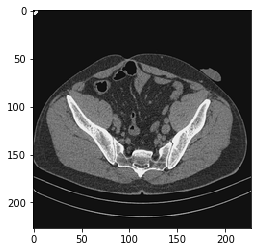

449
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


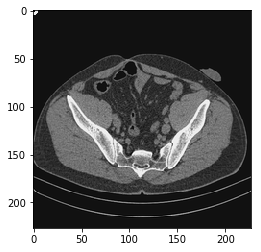

450
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


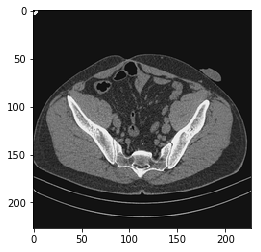

451
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


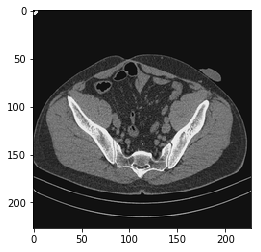

452
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


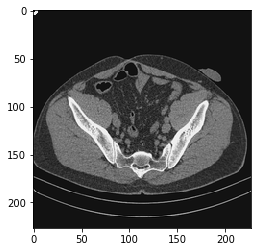

453
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


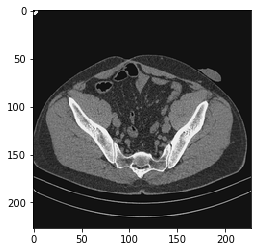

454
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


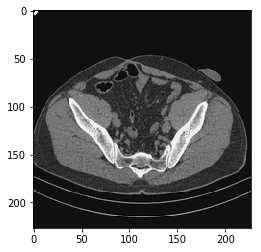

455
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


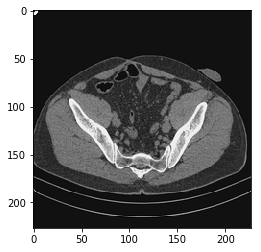

456
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


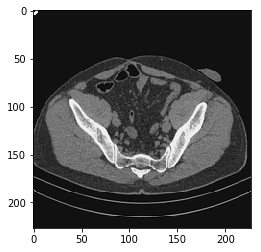

457
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


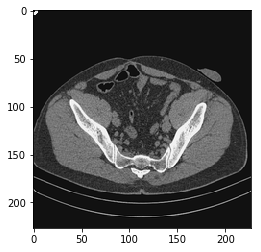

458
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


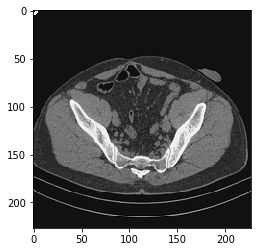

459
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


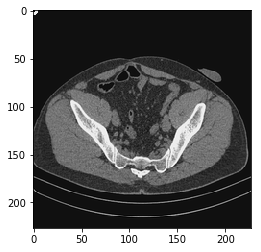

460
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


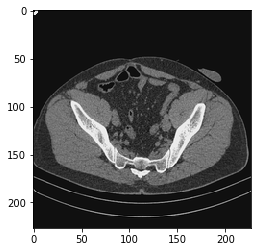

461
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


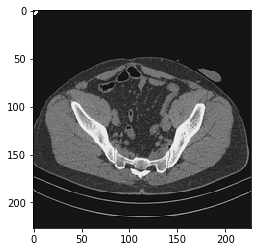

462
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


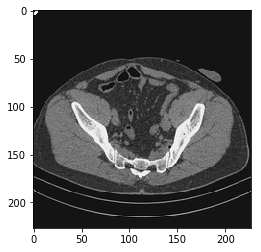

463
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


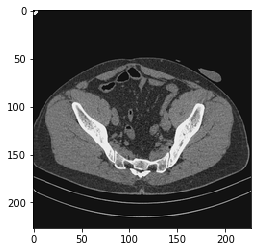

464
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


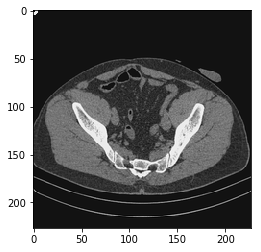

465
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


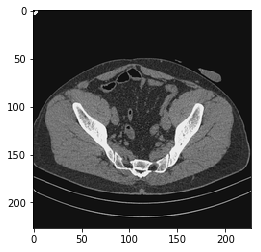

466
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


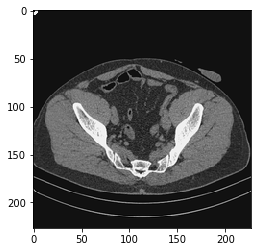

467
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


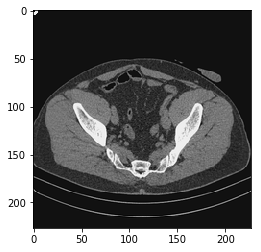

468
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


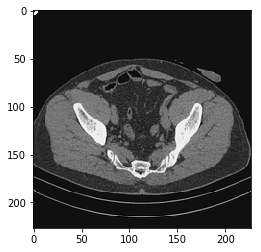

469
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


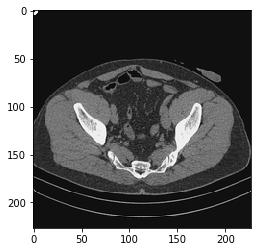

470
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


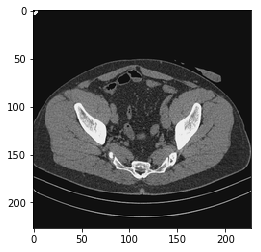

471
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


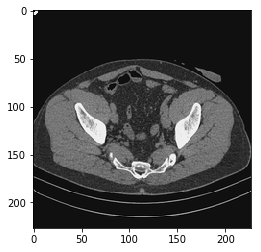

472
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


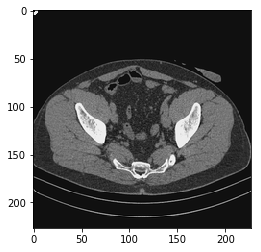

473
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


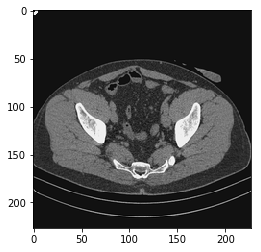

474
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


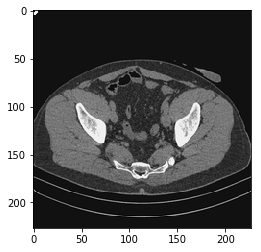

475
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


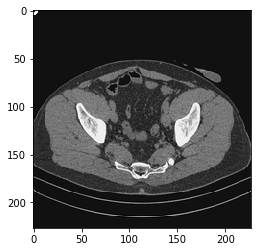

476
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


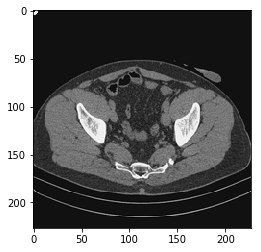

477
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


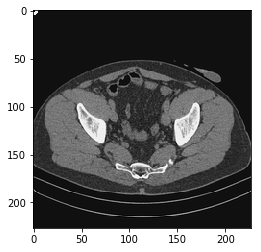

478
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


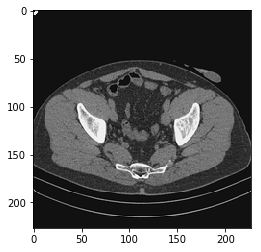

479
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


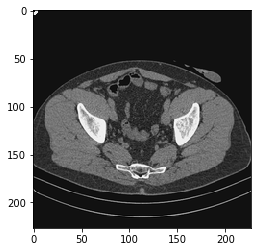

480
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


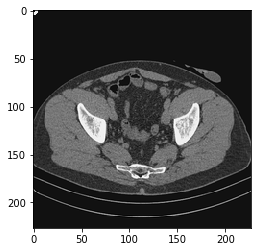

481
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


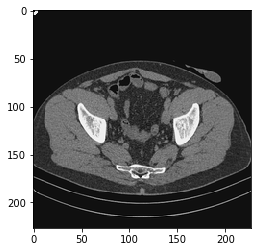

482
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


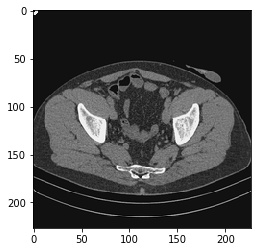

483
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


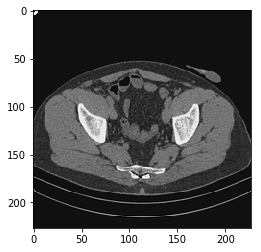

484
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


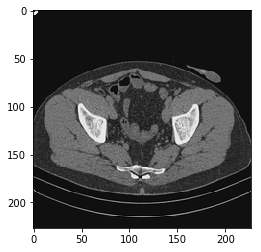

485
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


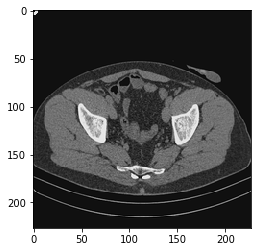

486
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


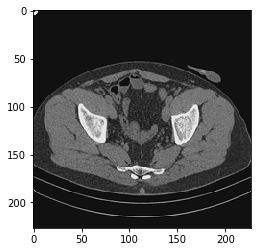

487
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


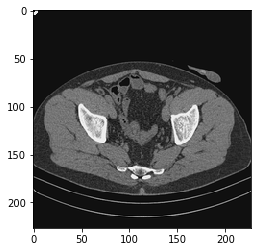

488
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


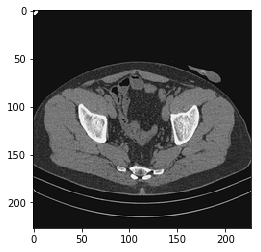

489
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


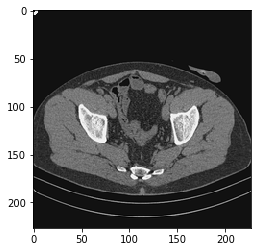

490
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


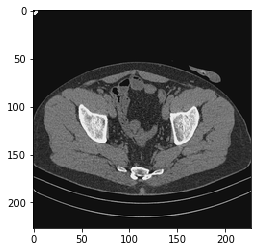

491
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


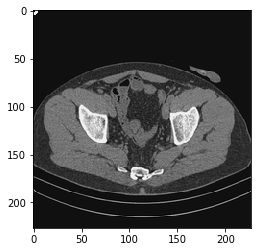

492
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


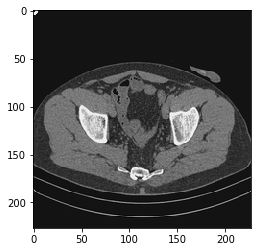

493
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


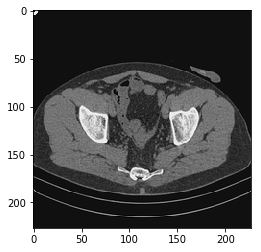

494
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


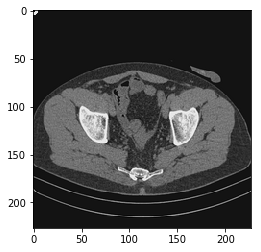

495
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


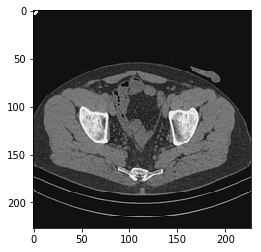

496
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


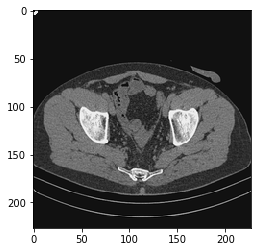

497
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


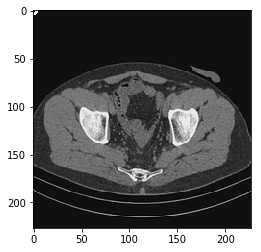

498
[[[0, 0], [0, 0]], [[0, 0], [0, 0]]]


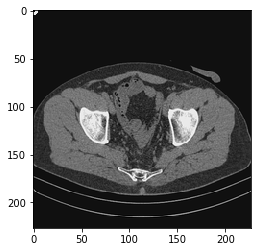

-4.05311584473e-06


In [38]:


config = tf.ConfigProto()
config.gpu_options.allow_growth = True
config.gpu_options.per_process_gpu_memory_fraction = 10.0
sess = tf.Session(config=config)

predictions = []
start = timeit.timeit()
with tf.Session() as sess:
    xnet = HourglassNet(num_classes=4, num_stacks=num_stack, num_channels=16, inres=(192, 192),
                                outres=(48, 48))
    xnet.load_model(model_json, model_weights)
    
    confth = 0.3
    mean = None
    for i, img in enumerate(images):
        print(i)
        imgdata = np.array(Image.fromarray(img).convert('RGB'))
        out, scale = xnet.inference_rgb(imgdata, imgdata.shape, mean)
        prediction = post_process_heatmap(out[0, :, :, :])
        
        leftKidneyConfidence = min(prediction[0][2], prediction[1][2])
        rightKidneyConfidence = min(prediction[2][2], prediction[3][2])

        leftKidneyPred = [[0,0], [0,0]]
        rightKidneyPred = [[0,0], [0,0]]
        if leftKidneyConfidence > confidence_threshold:
            leftKidneyPred = np.array([prediction[0][:2], prediction[1][:2]])*scale[1]*4
        if rightKidneyConfidence > confidence_threshold:
            rightKidneyPred = np.array([prediction[2][:2], prediction[3][:2]])*scale[0]*4
        mkps = list()
        mkps.append(leftKidneyPred)
        mkps.append(rightKidneyPred)
        print(mkps)
        img = render_joints(img, np.squeeze(mkps), 0.5)
        plt.imshow(img, cmap='gray')
        plt.show()
#         predictions.append([leftKidneyPred, rightKidneyPred])
#         kp_keys = MPIIDataGen.get_kp_keys()
#         mkps = list()
#         for i, _kp in enumerate(predictions):
#             _conf = _kp[2]
#             mkps.append((_kp[0] * scale[1] * 4, _kp[1] * scale[0] * 4, confidence_threshold))
#         predictions.append(mkps)
#         img = render_joints(img, mkps, confth)
#         plt.imshow(img, cmap='gray')
#         plt.show()
print(timeit.timeit() - start)


In [5]:
import pickle 
with open(os.path.join(output_folder, 'predictions.pickle'), 'rb') as handle:
    predictions = pickle.load(handle)

In [6]:
predictions = np.array(predictions)

In [7]:
predictions.shape

()

[16 26 19 30]


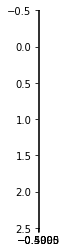

[14 25 19 30]


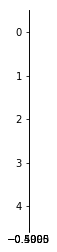

[14 25 19 30]


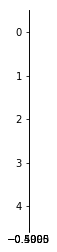

[14 25 19 30]


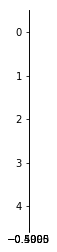

[13 26 18 30]


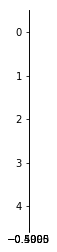

[13 26 18 30]


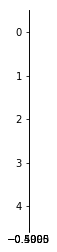

[13 26 18 30]


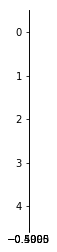

[16 26 18 30]


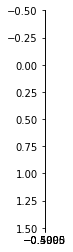

[13 25 18 30]


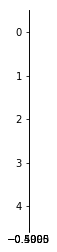

[13 25 18 30]


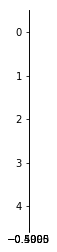

[13 26 18 29]


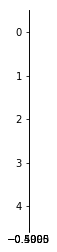

[13 26 18 29]


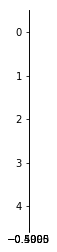

[13 26 17 29]


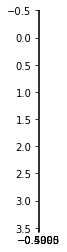

[13 26 17 29]


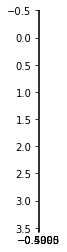

[13 26 17 29]


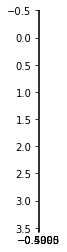

[13 27 16 30]


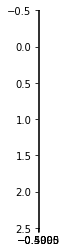

[13 26 17 30]


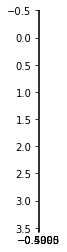

[13 27 18 31]


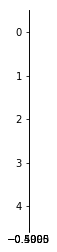

[13 26 18 31]


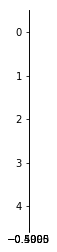

[13 26 18 31]


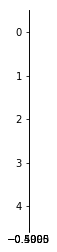

[13 26 18 31]


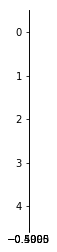

[13 26 18 31]


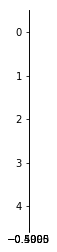

[13 26 18 31]


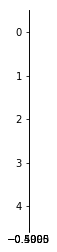

[12 26 18 31]


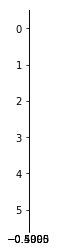

[12 26 18 31]


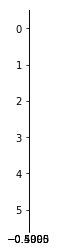

[12 26 18 31]


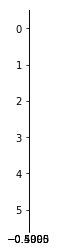

[12 25 18 31]


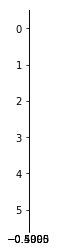

[12 25 18 31]


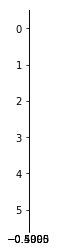

[12 25 18 31]


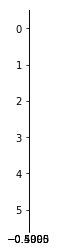

[12 25 18 31]


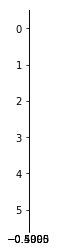

[12 25 18 31]


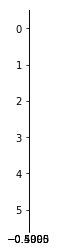

[12 25 18 31]


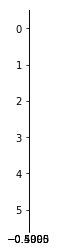

[11 25 18 31]


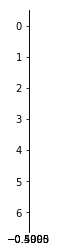

[12 25 18 31]


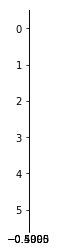

[11 25 18 31]


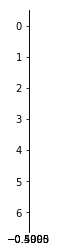

[11 25 18 31]


KeyboardInterrupt: 

In [34]:
for i, img in enumerate(images):
    left_kidney = predictions[i, 0].flatten()
    right_kidney = predictions[i, 1].flatten()
    if np.sum(left_kidney) != 0:
        print(left_kidney)
        left_kidney_img = img[left_kidney[0]:left_kidney[2], left_kidney[1]:left_kidney[2]]
        plt.imshow(left_kidney_img)
        plt.show()